In [ ]:
!pip install --upgrade pip
!pip install seaborn
!pip install scikit-image
!pip install opencv-python

!pip install kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/kaggle.json
!chmod 600 ~/.kaggle/kaggle.json

mkdir: cannot create directory ‘/root/.kaggle’: File exists


In [ ]:
!kaggle competitions download -c state-farm-distracted-driver-detection
!unzip 'state-farm-distracted-driver-detection.zip' -d 'data'

In [ ]:
import os
import random
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, log_loss
from sklearn.neighbors import NearestNeighbors
from statistics import mean

from skimage import io
from skimage import color
from PIL import Image
from dask.array.image import imread
from dask import bag, threaded
from dask.diagnostics import ProgressBar
import cv2
#RUN apt-get update (for cv2)
#RUN apt-get install ffmpeg libsm6 libxext6 -y (for cv2)

#ignore warning messages
import warnings
warnings.filterwarnings('ignore') 

#ignore TensorFlow warning messages
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization, Input, GlobalAveragePooling2D
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing import image 
from tensorflow.keras import optimizers
from keras.preprocessing.image import ImageDataGenerator
from keras.callbacks import ModelCheckpoint, EarlyStopping, LearningRateScheduler
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.applications.mobilenet import MobileNet

In [ ]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 12572996778644525803
xla_global_id: -1
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 16112943104
locality {
  bus_id: 1
  links {
  }
}
incarnation: 9859780877994923799
physical_device_desc: "device: 0, name: Quadro P5000, pci bus id: 0000:00:05.0, compute capability: 6.1"
xla_global_id: 416903419
]


# State Farm Distracted Driver Detection
### Can computer vision spot distracted drivers?

##### Dataset: https://www.kaggle.com/competitions/state-farm-distracted-driver-detection/data

##### The 10 classes to predict are:
    c0: safe driving
    c1: texting - right
    c2: talking on the phone - right
    c3: texting - left
    c4: talking on the phone - left
    c5: operating the radio
    c6: drinking
    c7: reaching behind
    c8: hair and makeup
    c9: talking to passenger

In [ ]:
classes = [
    'safe driving', 
    'texting - right', 
    'talking on the phone - right', 
    'texting - left', 
    'talking on the phone - left',
    'operating the radio',
    'drinking',
    'reaching behind',
    'hair and makeup',
    'talking to passenger'
]

## 1. CNN Model from Scratch (w/ Data Leakage)

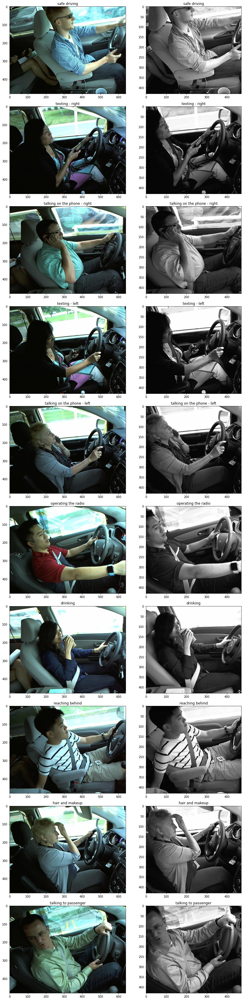

In [ ]:
#Original images along with a little editing
fig, ax = plt.subplots(10, 2, figsize=(6.4*2, 4.8*10))
for i in range(10):
    label_i_images = imread('data/imgs/train/c' + str(i) + '/*.jpg')
    image = label_i_images[0]
    ax[i][0].imshow(image)
    ax[i][0].set_title(classes[i])
    image = color.rgb2gray(image)
    image = image[50:,120:-50]
    ax[i][1].imshow(image, cmap='gray')
    ax[i][1].set_title(classes[i])
plt.tight_layout()
plt.show()

In [ ]:
#Grabbing images and their labels
train_images = []

for i in range(0, 10):
    print(f'Grabbing class: {classes[i]}')
    label_i_images = imread('data/imgs/train/c' + str(i) + '/*.jpg')
    for j in range(len(label_i_images)):
        image = label_i_images[j]
        image = color.rgb2gray(image)
        image = image[50:, 120:-50]
        image = cv2.resize(image, (150, 150))
        train_images.append([image, i])  

Grabbing class: safe driving
Grabbing class: texting - right
Grabbing class: talking on the phone - right
Grabbing class: texting - left
Grabbing class: talking on the phone - left
Grabbing class: operating the radio
Grabbing class: drinking
Grabbing class: reaching behind
Grabbing class: hair and makeup
Grabbing class: talking to passenger


In [ ]:
#Randomly shuffling the images
random.seed(42)
random.shuffle(train_images)

In [ ]:
#Splitting the images and the labels to two different lists
X = []
Y = []
for image, label in train_images:
    X.append(image)
    Y.append(label)
print(len(X))
print(len(Y))

#Converting the images (X) to numpy array and one-hot-encoding the labels (Y)
X = np.array(X).reshape(-1, 150, 150, 1)
Y = to_categorical(Y)
print(X.shape)
print(Y.shape)

22424
22424
(22424, 150, 150, 1)
(22424, 10)


In [ ]:
#80-20 Splitting of the images into train and test (validation)
X_train, X_test, y_train, y_test = train_test_split(X, Y, random_state=42, test_size=0.2)

In [ ]:
#Creating the architecture
model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(150,150,1), padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, kernel_size=(3,3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(64, kernel_size=(3,3), activation='relu', padding = 'same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(128, kernel_size=(3,3), activation='relu', padding = 'same'))
model.add(BatchNormalization())
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(10, activation='softmax'))

SGD = optimizers.SGD(learning_rate = 0.001)
model.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 150, 150, 32)      320       
                                                                 
 batch_normalization (BatchN  (None, 150, 150, 32)     128       
 ormalization)                                                   
                                                                 
 max_pooling2d (MaxPooling2D  (None, 75, 75, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 75, 75, 64)        18496     
                                                                 
 batch_normalization_1 (Batc  (None, 75, 75, 64)       256       
 hNormalization)                                                 
                                                        

In [ ]:
#Fitting the model
history = model.fit(X_train, y_train, epochs=3, validation_data=(X_test, y_test))

Epoch 1/3
561/561 [==============================] - 30s 47ms/step - loss: 0.3114 - accuracy: 0.9143 - val_loss: 0.3386 - val_accuracy: 0.9246
Epoch 2/3
561/561 [==============================] - 24s 43ms/step - loss: 0.0165 - accuracy: 0.9987 - val_loss: 0.0253 - val_accuracy: 0.9964
Epoch 3/3
561/561 [==============================] - 24s 42ms/step - loss: 0.0071 - accuracy: 0.9999 - val_loss: 0.0197 - val_accuracy: 0.9962


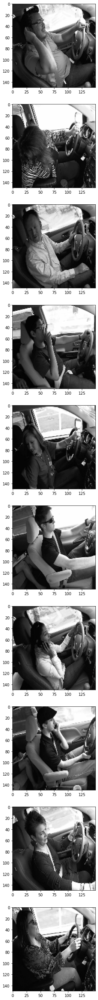

In [ ]:
#Grabbing the actual test images to test the model
test_images = []
fig, ax = plt.subplots(10, 1, figsize=(6.4*1, 4.8*10))

test_image_files = os.listdir('data/imgs/test')
np.random.seed(42)
nums = np.random.randint(low=0, high=len(test_image_files), size=10)
for i in range(10):
    image = cv2.imread('data/imgs/test/' + test_image_files[nums[i]])
    image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    image = cv2.resize(image, (150,150))
    test_images.append(image)
    ax[i].imshow(image, cmap='gray')
plt.show()

test_images = np.array(test_images).reshape(-1, 150, 150, 1)
test_image_predictions = model.predict(test_images)

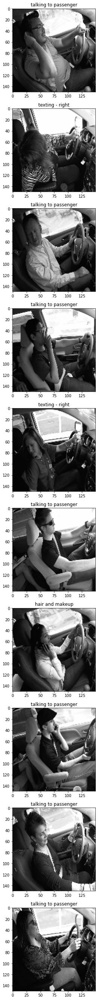

In [ ]:
#Plotting the predictions by the model on the actual test images
fig, ax = plt.subplots(10, 1, figsize = (6.4*1, 4.8*10))

for i in range(10):
    ax[i].imshow(test_images[i].squeeze(), cmap = 'gray')
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

## 2. CNN Model from Scratch (w/o Data Leakage) 

In [ ]:
#Loading the driver details
driver_details = pd.read_csv('data/driver_imgs_list.csv', na_values='na')
driver_details.head(5)

,subject,classname,img
0,p002,c0,img_44733.jpg
1,p002,c0,img_72999.jpg
2,p002,c0,img_25094.jpg
3,p002,c0,img_69092.jpg
4,p002,c0,img_92629.jpg


In [ ]:
#Grabbing all images along with label and driver details
train_images = []

for i in range(10):
    print(f'Grabbing class: {classes[i]}')
    images = os.listdir('data/imgs/train/c' + str(i))
    for j in range(len(images)):
        image = 'data/imgs/train/c' + str(i) + '/' + images[j]
        image = cv2.imread(image)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        image = image[50:,120:-50]
        image = cv2.resize(image,(150, 150))
        driver = driver_details[driver_details['img'] == images[j]]['subject'].values[0]
        train_images.append([image, i, driver])

Grabbing class: safe driving
Grabbing class: texting - right
Grabbing class: talking on the phone - right
Grabbing class: texting - left
Grabbing class: talking on the phone - left
Grabbing class: operating the radio
Grabbing class: drinking
Grabbing class: reaching behind
Grabbing class: hair and makeup
Grabbing class: talking to passenger


In [ ]:
#Randomly shuffling the images
random.seed(42)
random.shuffle(train_images)

In [ ]:
#Driver List
driver_list = driver_details.subject.unique()

#Selecting drivers at random for the validation set
drivers_selected = []
random.seed(42)
temp = random.sample(range(len(driver_list)), 4)
for i in temp:
    drivers_selected.append(driver_list[i])
    
#Splitting the images into train and test (validation) according to the drivers, so we'll have completely different drivers (subjects) in the test (validation) set to 
#prevent data leakage
X_train= []
y_train = []

X_test = []
y_test = []
for image, label, driver in train_images:
    if driver in drivers_selected:
        X_test.append(image)
        y_test.append(label)
    else:
        X_train.append(image)
        y_train.append(label)
    
print(len(X_train),len(X_test))
print(len(y_train),len(y_test))

19669 2755
19669 2755


In [ ]:
#Converting the images (X_train and X_test) to numpy arrays and one-hot-encoding the labels (y_train and y_test)
X_train = np.array(X_train).reshape(-1, 150, 150, 1)
X_test = np.array(X_test).reshape(-1, 150, 150, 1)
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(19669, 150, 150, 1)
(19669, 10)
(2755, 150, 150, 1)
(2755, 10)


In [ ]:
#Creating the architecture
model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(150, 150, 1), padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(128,kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(10, activation='softmax'))

SGD = optimizers.SGD(learning_rate=0.001)
model.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 150, 150, 32)      320       
                                                                 
 batch_normalization_4 (Batc  (None, 150, 150, 32)     128       
 hNormalization)                                                 
                                                                 
 conv2d_5 (Conv2D)           (None, 150, 150, 32)      9248      
                                                                 
 batch_normalization_5 (Batc  (None, 150, 150, 32)     128       
 hNormalization)                                                 
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 75, 75, 32)       0         
 2D)                                                             
                                                      

In [ ]:
#Fitting the model
history = model.fit(X_train, y_train, epochs=5, validation_data=(X_test, y_test))

Epoch 1/5
615/615 [==============================] - 36s 58ms/step - loss: 0.4977 - accuracy: 0.8604 - val_loss: 3.0218 - val_accuracy: 0.2515
Epoch 2/5
615/615 [==============================] - 35s 57ms/step - loss: 0.0462 - accuracy: 0.9949 - val_loss: 3.2912 - val_accuracy: 0.2450
Epoch 3/5
615/615 [==============================] - 34s 56ms/step - loss: 0.0200 - accuracy: 0.9992 - val_loss: 3.4185 - val_accuracy: 0.2559
Epoch 4/5
615/615 [==============================] - 34s 56ms/step - loss: 0.0121 - accuracy: 1.0000 - val_loss: 3.5075 - val_accuracy: 0.2577
Epoch 5/5
615/615 [==============================] - 34s 56ms/step - loss: 0.0088 - accuracy: 1.0000 - val_loss: 3.5394 - val_accuracy: 0.2599


In [ ]:
#Creating the architecture
model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', input_shape=(150, 150, 1), padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(32, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Conv2D(64, kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(128,kernel_size=(3, 3), activation='relu', padding='same'))
model.add(BatchNormalization())
model.add(Flatten())
model.add(Dense(128, activation='relu'))
model.add(Dense(10, activation='softmax'))

SGD = optimizers.SGD(learning_rate=0.001)
model.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_11 (Conv2D)          (None, 150, 150, 32)      320       
                                                                 
 batch_normalization_11 (Bat  (None, 150, 150, 32)     128       
 chNormalization)                                                
                                                                 
 conv2d_12 (Conv2D)          (None, 150, 150, 32)      9248      
                                                                 
 batch_normalization_12 (Bat  (None, 150, 150, 32)     128       
 chNormalization)                                                
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 75, 75, 32)       0         
 2D)                                                             
                                                      

In [ ]:
#Using data augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range = 0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size=64)

#Fitting the model on batches with real-time data augmentation
history = model.fit(data_generator, steps_per_epoch=len(X_train)/64, epochs=15, verbose=1, validation_data=(X_test, y_test))

Epoch 1/15
307/307 [==============================] - 42s 129ms/step - loss: 2.5234 - accuracy: 0.1100 - val_loss: 2.3348 - val_accuracy: 0.1162
Epoch 2/15
307/307 [==============================] - 39s 126ms/step - loss: 2.3521 - accuracy: 0.1192 - val_loss: 2.4235 - val_accuracy: 0.1147
Epoch 3/15
307/307 [==============================] - 39s 126ms/step - loss: 2.3115 - accuracy: 0.1285 - val_loss: 2.3999 - val_accuracy: 0.0987
Epoch 4/15
307/307 [==============================] - 39s 126ms/step - loss: 2.3000 - accuracy: 0.1302 - val_loss: 2.4006 - val_accuracy: 0.1132
Epoch 5/15
307/307 [==============================] - 41s 134ms/step - loss: 2.2888 - accuracy: 0.1396 - val_loss: 2.3480 - val_accuracy: 0.1343
Epoch 6/15
307/307 [==============================] - 39s 127ms/step - loss: 2.2794 - accuracy: 0.1455 - val_loss: 2.3340 - val_accuracy: 0.1525
Epoch 7/15
307/307 [==============================] - 40s 130ms/step - loss: 2.2753 - accuracy: 0.1444 - val_loss: 2.3313 - val_ac

## Setting up data for all further models.

In [ ]:
#Loading the driver details
driver_details = pd.read_csv('data/driver_imgs_list.csv', na_values='na')

#Grabbing all images along with label and driver details
train_images = []

for i in range(10):
    print(f'Grabbing class: {classes[i]}')
    images = os.listdir('data/imgs/train/c' + str(i))
    for j in range(len(images)):
        image = 'data/imgs/train/c' + str(i) + '/' + images[j]
        image = cv2.imread(image)
        image = image[50:,120:-50]
        image = cv2.resize(image,(150, 150))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        driver = driver_details[driver_details['img'] == images[j]]['subject'].values[0]
        train_images.append([image, i, driver])

Grabbing class: safe driving
Grabbing class: texting - right
Grabbing class: talking on the phone - right
Grabbing class: texting - left
Grabbing class: talking on the phone - left
Grabbing class: operating the radio
Grabbing class: drinking
Grabbing class: reaching behind
Grabbing class: hair and makeup
Grabbing class: talking to passenger


In [ ]:
#Randomly shuffling the images
random.seed(42)
random.shuffle(train_images)

In [ ]:
#Driver List
driver_list = driver_details.subject.unique()

#Selecting drivers at random for the validation set
random.seed(42)
drivers_selected = []
temp = random.sample(range(len(driver_list)), 4)
for i in temp:
    drivers_selected.append(driver_list[i])
print('The following drivers were selected for the validation set:', drivers_selected)
    
#Splitting the images into train and test (validation) according to the drivers, so we'll have completely different drivers (subjects) in the test (validation) set to 
#prevent data leakage
X_train= []
y_train = []

X_test = []
y_test = []
y_test_true = []
for image, label, driver in train_images:
    if driver in drivers_selected:
        X_test.append(image)
        y_test.append(label)
        y_test_true.append(label)
    else:
        X_train.append(image)
        y_train.append(label)
    
print(len(X_train), len(X_test))
print(len(y_train), len(y_test), len(y_test_true))

The following drivers were selected for the validation set: ['p061', 'p015', 'p002', 'p072']
19669 2755
19669 2755 2755


In [ ]:
#Converting the images (X_train and X_test) to numpy arrays and one-hot-encoding the labels (y_train and y_test)
X_train = np.array(X_train).reshape(-1, 150, 150, 3)
X_test = np.array(X_test).reshape(-1, 150, 150, 3)
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)
y_test_true = np.array(y_test_true)

print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)
print(y_test_true.shape)

(19669, 150, 150, 3)
(19669, 10)
(2755, 150, 150, 3)
(2755, 10)
(2755,)


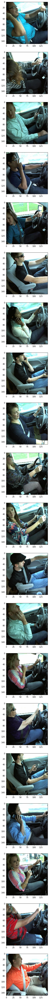

In [ ]:
#Grabbing the actual test images to test the model
test_images = []
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))
test_image_files = os.listdir('data/imgs/test')
np.random.seed(42)
nums = np.random.randint(low=0, high=len(test_image_files), size=20)
for i in range(20):
    image = cv2.imread('data/imgs/test/' + test_image_files[nums[i]])
    image = image[50:,120:-50]
    image = cv2.resize(image, (150,150))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    test_images.append(image)
    ax[i].imshow(image)
plt.show()

test_images = np.array(test_images).reshape(-1, 150, 150, 3)

## 3. Which optimizer to choose (Adam or SGD)? [trained using ResNet50]

### Implementing the model using ADAM

In [ ]:
#Defining the input
resnet50_input = Input(shape = (150, 150, 3), name='image_input')

#Getting the ResNet50 weights and layers trained on ImageNet
model_resnet50_convolution = ResNet50(weights='imagenet', include_top=False, input_shape=(150,150,3))
model_resnet50_convolution.summary()

2022-06-16 07:25:10.047989: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 07:25:10.048536: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 07:25:10.048644: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 07:25:10.049153: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 07:25:10.049422: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read f

94781440/94765736 [==============================] - 4s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 156, 156, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 75, 75, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalizat

In [ ]:
#Creating the architecture
output_resnet50_convolution = model_resnet50_convolution(resnet50_input)
x = Flatten(name='flatten')(output_resnet50_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

resnet50_pretrained = Model(inputs=resnet50_input, outputs=output)
resnet50_pretrained.summary()

#Compiling the CNN model with ADAM
ADAM = optimizers.Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999, epsilon=1e-8, decay=0.0)
resnet50_pretrained.compile(optimizer=ADAM, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 51200)             0         
                                                                 
 predictions (Dense)         (None, 10)                512010    
                                                                 
Total params: 24,099,722
Trainable params: 24,046,602
Non-trainable params: 53,120
_________________________________________________________________


In [ ]:
checkpointer = ModelCheckpoint('resnet50_alllayerstrained_adam_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range = 0.5,
    width_shift_range = 0.5,
    zoom_range = 0.5,
    rotation_range = 30
)
data_generator = datagen.flow(X_train, y_train, batch_size=64)

#Fitting the model on batches with real-time data augmentation
resnet50_model_history = resnet50_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper], 
                                                 epochs=25, verbose=1, validation_data=(X_test, y_test))

Epoch 1/25


2022-06-16 07:25:49.696376: I tensorflow/stream_executor/cuda/cuda_dnn.cc:377] Loaded cuDNN version 8302


308/307 [==============================] - ETA: 0s - loss: 2.6825 - accuracy: 0.1231
Epoch 00001: val_loss improved from inf to 4.03503, saving model to resnet50_alllayerstrained_adam_augmented.hdf5


/usr/local/lib/python3.8/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


307/307 [==============================] - 100s 293ms/step - loss: 2.6825 - accuracy: 0.1231 - val_loss: 4.0350 - val_accuracy: 0.1180
Epoch 2/25
308/307 [==============================] - ETA: 0s - loss: 1.7383 - accuracy: 0.3578
Epoch 00002: val_loss improved from 4.03503 to 1.72143, saving model to resnet50_alllayerstrained_adam_augmented.hdf5
307/307 [==============================] - 88s 286ms/step - loss: 1.7383 - accuracy: 0.3578 - val_loss: 1.7214 - val_accuracy: 0.5619
Epoch 3/25
308/307 [==============================] - ETA: 0s - loss: 1.0364 - accuracy: 0.6256
Epoch 00003: val_loss did not improve from 1.72143
307/307 [==============================] - 86s 280ms/step - loss: 1.0364 - accuracy: 0.6256 - val_loss: 3.2359 - val_accuracy: 0.4167
Epoch 4/25
308/307 [==============================] - ETA: 0s - loss: 0.7905 - accuracy: 0.7200
Epoch 00004: val_loss did not improve from 1.72143
307/307 [==============================] - 86s 278ms/step - loss: 0.7905 - accuracy: 0.72

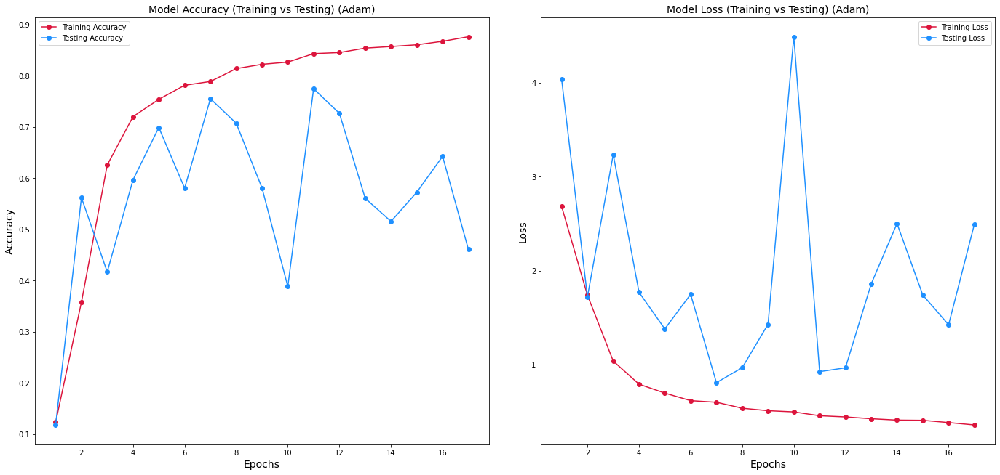

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize=(20, 10))

#First plot
ax[0].plot(range(1, len(resnet50_pretrained.history.history['accuracy']) + 1), resnet50_pretrained.history.history['accuracy'], linestyle='solid', marker='o', color='crimson', label='Training Accuracy')
ax[0].plot(range(1, len(resnet50_pretrained.history.history['val_accuracy']) + 1), resnet50_pretrained.history.history['val_accuracy'], linestyle='solid', marker='o', color='dodgerblue', label='Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize=14)
ax[0].set_ylabel('Accuracy', fontsize=14)
ax[0].set_title('Model Accuracy (Training vs Testing) (Adam)', fontsize=14)
ax[0].legend(loc='best')

#Second plot
ax[1].plot(range(1, len(resnet50_pretrained.history.history['loss']) + 1), resnet50_pretrained.history.history['loss'], linestyle='solid', marker='o', color='crimson', label='Training Loss')
ax[1].plot(range(1, len(resnet50_pretrained.history.history['val_loss']) + 1), resnet50_pretrained.history.history['val_loss'], linestyle='solid', marker='o', color='dodgerblue', label='Testing Loss')
ax[1].set_xlabel('Epochs', fontsize=14)
ax[1].set_ylabel('Loss', fontsize=14)
ax[1].set_title('Model Loss (Training vs Testing) (Adam)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
resnet50_pretrained.load_weights('resnet50_alllayerstrained_adam_augmented.hdf5')
test_image_predictions = resnet50_pretrained.predict(test_images)

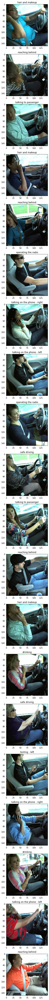

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

### Implementing the model using SGD

In [ ]:
#Defining the input
resnet50_input = Input(shape = (150, 150, 3), name='image_input')

#Getting the ResNet50 weights and layers trained on ImageNet
model_resnet50_convolution = ResNet50(weights='imagenet', include_top=False, input_shape=(150, 150, 3))
model_resnet50_convolution.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 156, 156, 3)  0           ['input_2[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 75, 75, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 75, 75, 64)   256         ['conv1_conv[0][0]']      

In [ ]:
#Creating the architecture
output_resnet50_convolution = model_resnet50_convolution(resnet50_input)
x = Flatten(name='flatten')(output_resnet50_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

resnet50_pretrained = Model(inputs=resnet50_input, outputs=output)
resnet50_pretrained.summary()

#Compiling the CNN model with SGD
SGD = optimizers.SGD(learning_rate=0.01)
resnet50_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 51200)             0         
                                                                 
 predictions (Dense)         (None, 10)                512010    
                                                                 
Total params: 24,099,722
Trainable params: 24,046,602
Non-trainable params: 53,120
_________________________________________________________________


In [ ]:
checkpointer = ModelCheckpoint('resnet50_alllayerstrained_sgd_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range = 0.5,
    width_shift_range = 0.5,
    zoom_range = 0.5,
    rotation_range = 30
)
data_generator = datagen.flow(X_train, y_train, batch_size=64)

#Fitting the model on batches with real-time data augmentation
resnet50_model_history = resnet50_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper], 
                                                 epochs=25, verbose=1, validation_data=(X_test, y_test))

Epoch 1/25
308/307 [==============================] - ETA: 0s - loss: 2.6676 - accuracy: 0.2488
Epoch 00001: val_loss improved from inf to 1.88927, saving model to resnet50_alllayerstrained_sgd_augmented.hdf5
307/307 [==============================] - 92s 288ms/step - loss: 2.6676 - accuracy: 0.2488 - val_loss: 1.8893 - val_accuracy: 0.3978
Epoch 2/25
308/307 [==============================] - ETA: 0s - loss: 1.0856 - accuracy: 0.6246
Epoch 00002: val_loss improved from 1.88927 to 1.43306, saving model to resnet50_alllayerstrained_sgd_augmented.hdf5
307/307 [==============================] - 88s 285ms/step - loss: 1.0856 - accuracy: 0.6246 - val_loss: 1.4331 - val_accuracy: 0.6123
Epoch 3/25
308/307 [==============================] - ETA: 0s - loss: 0.7112 - accuracy: 0.7549
Epoch 00003: val_loss did not improve from 1.43306
307/307 [==============================] - 87s 281ms/step - loss: 0.7112 - accuracy: 0.7549 - val_loss: 1.6827 - val_accuracy: 0.6033
Epoch 4/25
308/307 [=========

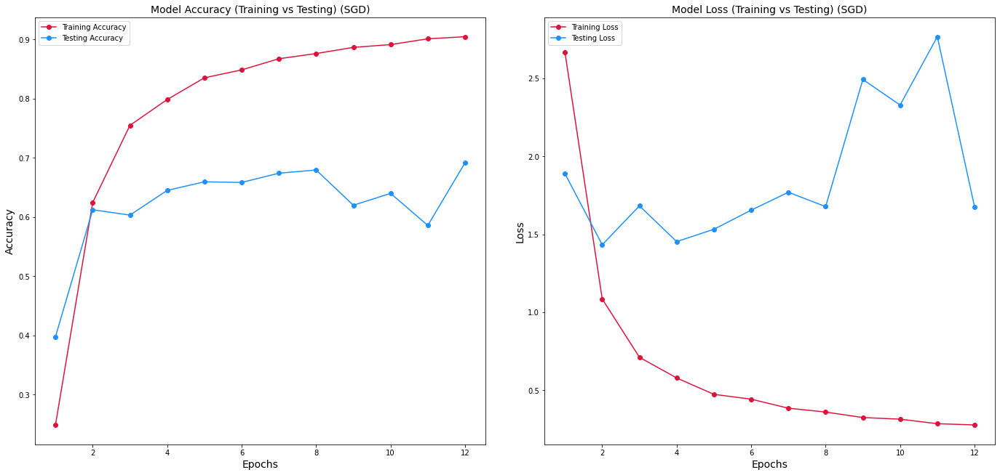

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize=(20, 10))

#First plot
ax[0].plot(range(1, len(resnet50_pretrained.history.history['accuracy']) + 1), resnet50_pretrained.history.history['accuracy'], linestyle='solid', marker='o', color='crimson', label='Training Accuracy')
ax[0].plot(range(1, len(resnet50_pretrained.history.history['val_accuracy']) + 1), resnet50_pretrained.history.history['val_accuracy'], linestyle='solid', marker='o', color='dodgerblue', label='Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize=14)
ax[0].set_ylabel('Accuracy', fontsize=14)
ax[0].set_title('Model Accuracy (Training vs Testing) (SGD)', fontsize=14)
ax[0].legend(loc='best')

#Second plot
ax[1].plot(range(1, len(resnet50_pretrained.history.history['loss']) + 1), resnet50_pretrained.history.history['loss'], linestyle='solid', marker='o', color='crimson', label='Training Loss')
ax[1].plot(range(1, len(resnet50_pretrained.history.history['val_loss']) + 1), resnet50_pretrained.history.history['val_loss'], linestyle='solid', marker='o', color='dodgerblue', label='Testing Loss')
ax[1].set_xlabel('Epochs', fontsize=14)
ax[1].set_ylabel('Loss', fontsize=14)
ax[1].set_title('Model Loss (Training vs Testing) (SGD)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
resnet50_pretrained.load_weights('resnet50_alllayerstrained_sgd_augmented.hdf5')
test_image_predictions = resnet50_pretrained.predict(test_images)

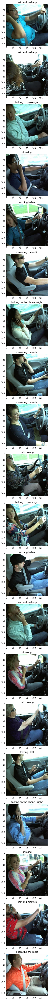

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

### Conclusion - As SGD shows better, smoother training and a gradual descent as compared to Adam which shows somewhat of an erratic descent, I will use SGD for training all further models.

## 4. What all layers to train (Only the extra layers or all the layers)? (trained using VGG16)

### Training only the extra layers

In [ ]:
#Defining the input
vgg16_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the VGG16 weights and layers trained on ImageNet
model_vgg16_convolution = VGG16(weights='imagenet', include_top=False, input_tensor=vgg16_input)
model_vgg16_convolution.summary()

58900480/58889256 [==============================] - 2s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 150, 150, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 150, 150, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 75, 75, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 75, 75, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 75, 75, 128)       147584    
                                                              

In [ ]:
#Creating the architecture
output_vgg16_convolution = model_vgg16_convolution(vgg16_input)
x = Flatten(name='flatten')(output_vgg16_convolution)
x = Dense(4096, activation='relu', name='fc1')(x)
x = Dense(4096, activation='relu', name='fc2')(x)
output = Dense(10, activation='softmax', name='predictions')(x)

#Freezing the VGG16 model layers
vgg16_pretrained = Model(inputs=vgg16_input, outputs=output)
for layer in vgg16_pretrained.layers[:2]:
    layer.trainable = False
for layer in vgg16_pretrained.layers[2:]:
    layer.trainable = True

vgg16_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.001)
vgg16_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 fc1 (Dense)                 (None, 4096)              33558528  
                                                                 
 fc2 (Dense)                 (None, 4096)              16781312  
                                                                 
 predictions (Dense)         (None, 10)                40970     
                                                                 
Total params: 65,095,498
Trainable params: 50,380,810
Non-t

In [ ]:
checkpointer = ModelCheckpoint('vgg16_lastlayerstrained_sgd_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range=0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size=64)

#Fitting the model on batches with real-time data augmentation
vgg16_model = vgg16_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper],
                                   epochs=25, verbose=1, validation_data=(X_test, y_test))

Epoch 1/25
308/307 [==============================] - ETA: 0s - loss: 6.1591 - accuracy: 0.2116
Epoch 00001: val_loss improved from inf to 3.89160, saving model to vgg16_lastlayerstrained_sgd_augmented.hdf5
307/307 [==============================] - 88s 284ms/step - loss: 6.1591 - accuracy: 0.2116 - val_loss: 3.8916 - val_accuracy: 0.2646
Epoch 2/25
308/307 [==============================] - ETA: 0s - loss: 2.5317 - accuracy: 0.3096
Epoch 00002: val_loss improved from 3.89160 to 3.06093, saving model to vgg16_lastlayerstrained_sgd_augmented.hdf5
307/307 [==============================] - 87s 284ms/step - loss: 2.5317 - accuracy: 0.3096 - val_loss: 3.0609 - val_accuracy: 0.3045
Epoch 3/25
308/307 [==============================] - ETA: 0s - loss: 2.0885 - accuracy: 0.3551
Epoch 00003: val_loss improved from 3.06093 to 2.69641, saving model to vgg16_lastlayerstrained_sgd_augmented.hdf5
307/307 [==============================] - 88s 285ms/step - loss: 2.0885 - accuracy: 0.3551 - val_loss:

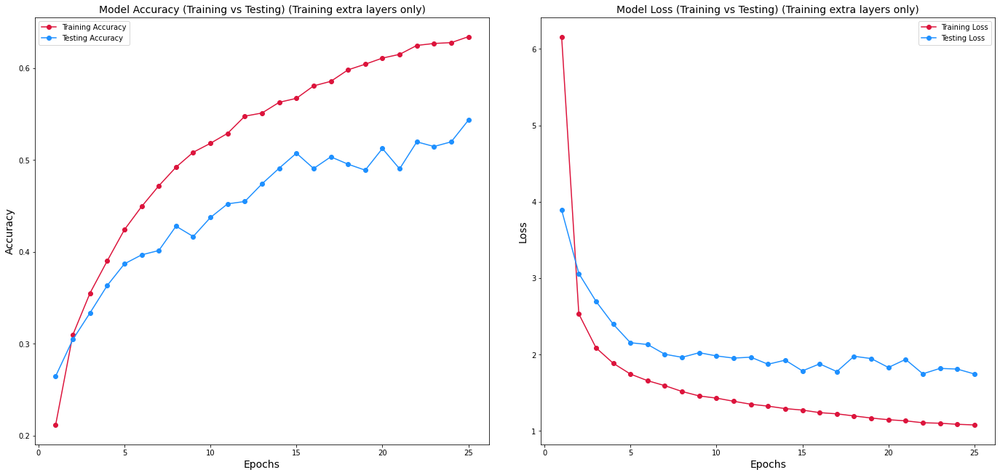

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(vgg16_pretrained.history.history['accuracy']) + 1), vgg16_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(vgg16_pretrained.history.history['val_accuracy']) + 1), vgg16_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (Training extra layers only)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(vgg16_pretrained.history.history['loss']) + 1), vgg16_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(vgg16_pretrained.history.history['val_loss']) + 1), vgg16_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (Training extra layers only)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
vgg16_pretrained.load_weights('vgg16_lastlayerstrained_sgd_augmented.hdf5')
test_image_predictions = vgg16_pretrained.predict(test_images)

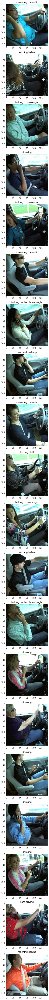

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

### Training all the layers

In [ ]:
#Defining the input
vgg16_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the VGG16 weights and layers trained on ImageNet
model_vgg16_convolution = VGG16(weights='imagenet', include_top=False, input_tensor=vgg16_input)
model_vgg16_convolution.summary()

2022-06-16 09:07:20.032690: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 09:07:20.033122: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 09:07:20.033357: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 09:07:20.033912: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 09:07:20.034187: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read f

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 150, 150, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 150, 150, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 75, 75, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 75, 75, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 75, 75, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 37, 37, 128)       0     

In [ ]:
#Creating the architecture
output_vgg16_convolution = model_vgg16_convolution(vgg16_input)
x = Flatten(name='flatten')(output_vgg16_convolution)
x = Dense(4096, activation='relu', name='fc1')(x)
x = Dense(4096, activation='relu', name='fc2')(x)
output = Dense(10, activation='softmax', name='predictions')(x)

vgg16_pretrained = Model(inputs=vgg16_input, outputs=output)
vgg16_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.001)
vgg16_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 fc1 (Dense)                 (None, 4096)              33558528  
                                                                 
 fc2 (Dense)                 (None, 4096)              16781312  
                                                                 
 predictions (Dense)         (None, 10)                40970     
                                                                 
Total params: 65,095,498
Trainable params: 65,095,498
Non-tra

In [ ]:
checkpointer = ModelCheckpoint('vgg16_alllayerstrained_sgd_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range=0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size=64)

#Fitting the model on batches with real-time data augmentation
vgg16_model = vgg16_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper],
                                   epochs=25, verbose=1, validation_data=(X_test, y_test))

Epoch 1/25


2022-06-16 09:07:26.076905: I tensorflow/stream_executor/cuda/cuda_dnn.cc:377] Loaded cuDNN version 8302


308/307 [==============================] - ETA: 0s - loss: 2.3641 - accuracy: 0.1076
Epoch 00001: val_loss improved from inf to 2.30558, saving model to vgg16_alllayerstrained_sgd_augmented.hdf5
307/307 [==============================] - 102s 312ms/step - loss: 2.3641 - accuracy: 0.1076 - val_loss: 2.3056 - val_accuracy: 0.1162
Epoch 2/25
308/307 [==============================] - ETA: 0s - loss: 2.2938 - accuracy: 0.1122
Epoch 00002: val_loss improved from 2.30558 to 2.28633, saving model to vgg16_alllayerstrained_sgd_augmented.hdf5
307/307 [==============================] - 88s 286ms/step - loss: 2.2938 - accuracy: 0.1122 - val_loss: 2.2863 - val_accuracy: 0.1408
Epoch 3/25
308/307 [==============================] - ETA: 0s - loss: 2.2841 - accuracy: 0.1223
Epoch 00003: val_loss improved from 2.28633 to 2.26602, saving model to vgg16_alllayerstrained_sgd_augmented.hdf5
307/307 [==============================] - 89s 289ms/step - loss: 2.2841 - accuracy: 0.1223 - val_loss: 2.2660 - val

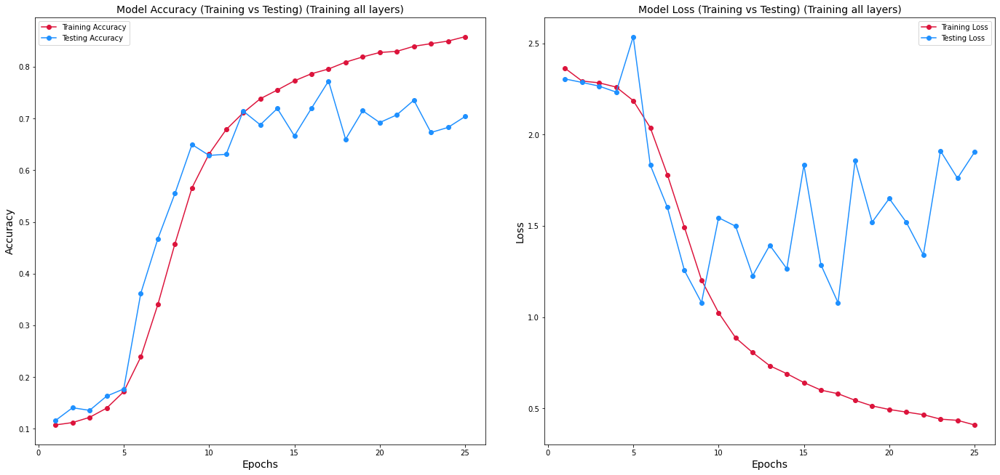

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(vgg16_pretrained.history.history['accuracy']) + 1), vgg16_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(vgg16_pretrained.history.history['val_accuracy']) + 1), vgg16_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (Training all layers)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(vgg16_pretrained.history.history['loss']) + 1), vgg16_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(vgg16_pretrained.history.history['val_loss']) + 1), vgg16_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (Training all layers)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
vgg16_pretrained.load_weights('vgg16_alllayerstrained_sgd_augmented.hdf5')
test_image_predictions = vgg16_pretrained.predict(test_images)

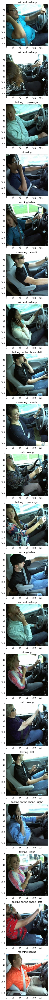

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

### Conclusion - As a better accuracy is achieved when all the layers are trained as compared to the accuracy achieved when training just the final layers, I will train all the layers for all further models.

## 5. Model 1: VGG16 + SGD + No Extra Layers

In [ ]:
#Defining the input
vgg16_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the VGG16 weights and layers trained on ImageNet
model_vgg16_convolution = VGG16(weights='imagenet', include_top=False, input_tensor=vgg16_input)
model_vgg16_convolution.summary()

2022-06-16 09:53:32.345981: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 09:53:32.346474: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 09:53:32.346612: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 09:53:32.347124: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 09:53:32.347389: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read f

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 150, 150, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 150, 150, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 75, 75, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 75, 75, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 75, 75, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 37, 37, 128)       0     

In [ ]:
#Creating the architecture
output_vgg16_convolution = model_vgg16_convolution(vgg16_input)
x = Flatten(name='flatten')(output_vgg16_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

vgg16_pretrained = Model(inputs=vgg16_input, outputs=output)
vgg16_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.001)
vgg16_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 flatten (Flatten)           (None, 8192)              0         
                                                                 
 predictions (Dense)         (None, 10)                81930     
                                                                 
Total params: 14,796,618
Trainable params: 14,796,618
Non-trainable params: 0
_________________________________________________________________


In [ ]:
checkpointer = ModelCheckpoint('vgg16_noextralayers_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range=0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size=64)

#Fitting the model on batches with real-time data augmentation
vgg16_model = vgg16_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper],
                                   epochs=25, verbose=1, validation_data=(X_test, y_test))

Epoch 1/25


2022-06-16 09:53:37.919655: I tensorflow/stream_executor/cuda/cuda_dnn.cc:377] Loaded cuDNN version 8302


308/307 [==============================] - ETA: 0s - loss: 2.3542 - accuracy: 0.1401
Epoch 00001: val_loss improved from inf to 2.44560, saving model to vgg16_noextralayers_augmented.hdf5
307/307 [==============================] - 98s 298ms/step - loss: 2.3542 - accuracy: 0.1401 - val_loss: 2.4456 - val_accuracy: 0.1601
Epoch 2/25
308/307 [==============================] - ETA: 0s - loss: 2.1334 - accuracy: 0.1889
Epoch 00002: val_loss improved from 2.44560 to 1.76636, saving model to vgg16_noextralayers_augmented.hdf5
307/307 [==============================] - 87s 282ms/step - loss: 2.1334 - accuracy: 0.1889 - val_loss: 1.7664 - val_accuracy: 0.2465
Epoch 3/25
308/307 [==============================] - ETA: 0s - loss: 1.9177 - accuracy: 0.2589
Epoch 00003: val_loss improved from 1.76636 to 1.66727, saving model to vgg16_noextralayers_augmented.hdf5
307/307 [==============================] - 87s 282ms/step - loss: 1.9177 - accuracy: 0.2589 - val_loss: 1.6673 - val_accuracy: 0.3416
Epoc

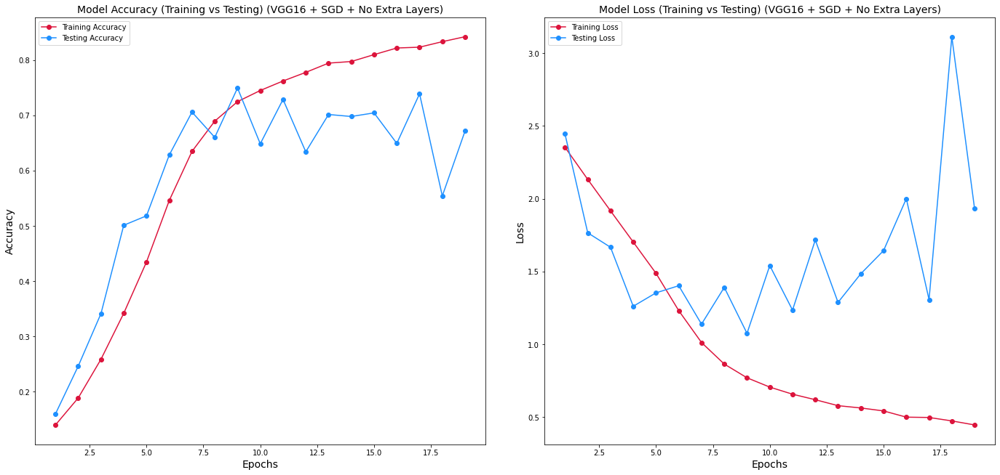

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(vgg16_pretrained.history.history['accuracy']) + 1), vgg16_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(vgg16_pretrained.history.history['val_accuracy']) + 1), vgg16_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (VGG16 + SGD + No Extra Layers)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(vgg16_pretrained.history.history['loss']) + 1), vgg16_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(vgg16_pretrained.history.history['val_loss']) + 1), vgg16_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (VGG16 + SGD + No Extra Layers)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
vgg16_pretrained.load_weights('vgg16_noextralayers_augmented.hdf5')
test_image_predictions = vgg16_pretrained.predict(test_images)

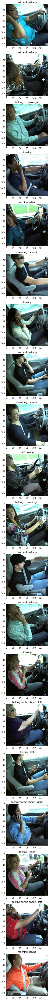

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

## 6. Model 2: VGG16 + SGD + Extra Layers

In [ ]:
#Defining the input
vgg16_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the VGG16 weights and layers trained on ImageNet
model_vgg16_convolution = VGG16(weights='imagenet', include_top=False, input_tensor=vgg16_input)
model_vgg16_convolution.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 150, 150, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 150, 150, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 75, 75, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 75, 75, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 75, 75, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 37, 37, 128)       0     

In [ ]:
#Creating the architecture
output_vgg16_convolution = model_vgg16_convolution(vgg16_input)
x = GlobalAveragePooling2D()(output_vgg16_convolution)
#Adding these dense layers so that the model can learn more complex functions and classify with better accuracy
x = Dense(1024, activation='relu')(x) 
x = Dropout(0.1)(x) 
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
output = Dense(10, activation='softmax', name='predictions')(x)

vgg16_pretrained = Model(inputs=vgg16_input, outputs=output)
vgg16_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.001)
vgg16_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 vgg16 (Functional)          (None, 4, 4, 512)         14714688  
                                                                 
 global_average_pooling2d_1   (None, 512)              0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_3 (Dense)             (None, 1024)              525312    
                                                                 
 dropout_2 (Dropout)         (None, 1024)              0         
                                                                 
 dense_4 (Dense)             (None, 1024)              1049600   
                                                           

In [ ]:
checkpointer = ModelCheckpoint('vgg16_extralayers_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range = 0.5,
    zoom_range = 0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size = 64)

#Fitting the model on batches with real-time data augmentation
vgg16_model = vgg16_pretrained.fit(data_generator, steps_per_epoch = len(X_train) / 64, callbacks=[checkpointer, earlystopper],
                                             epochs = 25, verbose = 1, validation_data = (X_test, y_test))

Epoch 1/25
308/307 [==============================] - ETA: 0s - loss: 2.8121 - accuracy: 0.1015
Epoch 00001: val_loss improved from inf to 4.14060, saving model to vgg16_extralayers_augmented.hdf5
307/307 [==============================] - 90s 289ms/step - loss: 2.8121 - accuracy: 0.1015 - val_loss: 4.1406 - val_accuracy: 0.0842
Epoch 2/25
308/307 [==============================] - ETA: 0s - loss: 2.6843 - accuracy: 0.1050
Epoch 00002: val_loss improved from 4.14060 to 2.33195, saving model to vgg16_extralayers_augmented.hdf5
307/307 [==============================] - 87s 283ms/step - loss: 2.6843 - accuracy: 0.1050 - val_loss: 2.3319 - val_accuracy: 0.0813
Epoch 3/25
308/307 [==============================] - ETA: 0s - loss: 2.5881 - accuracy: 0.1010
Epoch 00003: val_loss did not improve from 2.33195
307/307 [==============================] - 90s 291ms/step - loss: 2.5881 - accuracy: 0.1010 - val_loss: 2.3360 - val_accuracy: 0.1002
Epoch 4/25
308/307 [==============================] -

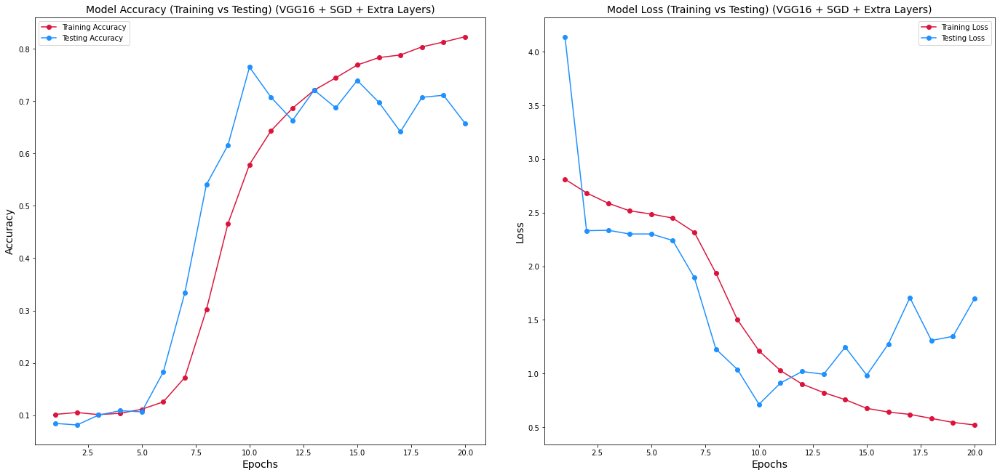

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(vgg16_pretrained.history.history['accuracy']) + 1), vgg16_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(vgg16_pretrained.history.history['val_accuracy']) + 1), vgg16_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (VGG16 + SGD + Extra Layers)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(vgg16_pretrained.history.history['loss']) + 1), vgg16_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(vgg16_pretrained.history.history['val_loss']) + 1), vgg16_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (VGG16 + SGD + Extra Layers)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
vgg16_pretrained.load_weights('vgg16_extralayers_augmented.hdf5')
test_image_predictions = vgg16_pretrained.predict(test_images)

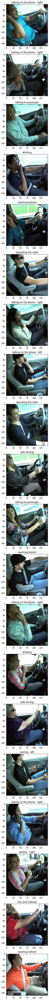

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

## 7. Model 3: ResNet50 + SGD + No Extra Layers

In [ ]:
#Defining the input
resnet50_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the ResNet50 weights and layers trained on ImageNet
model_resnet50_convolution = ResNet50(weights='imagenet', include_top=False, input_tensor=resnet50_input)
model_resnet50_convolution.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 image_input (InputLayer)       [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 156, 156, 3)  0           ['image_input[0][0]']            
                                                                                                  
 conv1_conv (Conv2D)            (None, 75, 75, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 75, 75, 64)   256         ['conv1_conv[0][0]']      

In [ ]:
#Creating the architecture
output_resnet50_convolution = model_resnet50_convolution(resnet50_input)
x = Flatten(name='flatten')(output_resnet50_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

resnet50_pretrained = Model(inputs=resnet50_input, outputs=output)
resnet50_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.001)
resnet50_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 flatten (Flatten)           (None, 51200)             0         
                                                                 
 predictions (Dense)         (None, 10)                512010    
                                                                 
Total params: 24,099,722
Trainable params: 24,046,602
Non-trainable params: 53,120
_________________________________________________________________


In [ ]:
checkpointer = ModelCheckpoint('resnet50_noextralayers_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='accuracy', patience=7, verbose=1)
def step_decay(epoch):
    initial_learning_rate = 0.001
    drop = 0.5
    epochs_drop = 10.0
    learning_rate = initial_learning_rate * math.pow(drop, math.floor((1+epoch)/epochs_drop))
    return learning_rate
learning_rate = LearningRateScheduler(step_decay)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range=0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size=64)

#Fitting the model on batches with real-time data augmentation
resnet50_model = resnet50_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper, learning_rate],
                                         epochs=40, verbose=1, validation_data=(X_test, y_test))

Epoch 1/40


2022-06-16 14:25:16.419869: I tensorflow/stream_executor/cuda/cuda_dnn.cc:377] Loaded cuDNN version 8302


308/307 [==============================] - ETA: 0s - loss: 2.5877 - accuracy: 0.2834
Epoch 00001: val_loss improved from inf to 2.68620, saving model to resnet50_noextralayers_augmented.hdf5


/usr/local/lib/python3.8/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


307/307 [==============================] - 96s 288ms/step - loss: 2.5877 - accuracy: 0.2834 - val_loss: 2.6862 - val_accuracy: 0.3819 - lr: 0.0010
Epoch 2/40
308/307 [==============================] - ETA: 0s - loss: 1.6367 - accuracy: 0.5027
Epoch 00002: val_loss improved from 2.68620 to 1.81992, saving model to resnet50_noextralayers_augmented.hdf5
307/307 [==============================] - 87s 281ms/step - loss: 1.6367 - accuracy: 0.5027 - val_loss: 1.8199 - val_accuracy: 0.5499 - lr: 0.0010
Epoch 3/40
308/307 [==============================] - ETA: 0s - loss: 1.2401 - accuracy: 0.6095
Epoch 00003: val_loss did not improve from 1.81992
307/307 [==============================] - 85s 277ms/step - loss: 1.2401 - accuracy: 0.6095 - val_loss: 1.8289 - val_accuracy: 0.5811 - lr: 0.0010
Epoch 4/40
308/307 [==============================] - ETA: 0s - loss: 1.0093 - accuracy: 0.6775
Epoch 00004: val_loss improved from 1.81992 to 1.54832, saving model to resnet50_noextralayers_augmented.hdf5


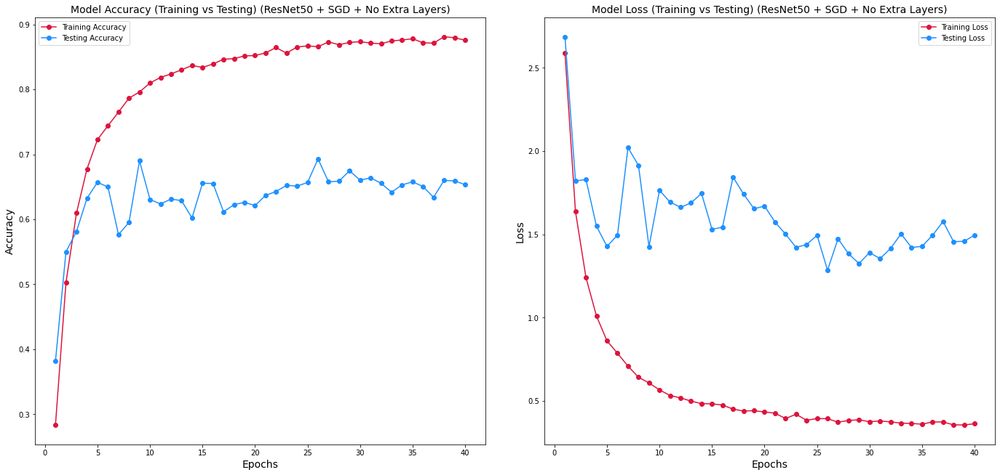

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(resnet50_pretrained.history.history['accuracy']) + 1), resnet50_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(resnet50_pretrained.history.history['val_accuracy']) + 1), resnet50_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (ResNet50 + SGD + No Extra Layers)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(resnet50_pretrained.history.history['loss']) + 1), resnet50_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(resnet50_pretrained.history.history['val_loss']) + 1), resnet50_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (ResNet50 + SGD + No Extra Layers)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
resnet50_pretrained.load_weights('resnet50_noextralayers_augmented.hdf5')
test_image_predictions = resnet50_pretrained.predict(test_images)

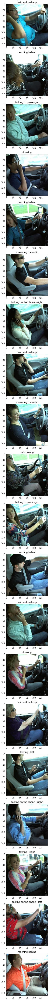

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

## 8. Model 4: ResNet50 + SGD + Extra Layers

In [ ]:
#Defining the input
resnet50_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the ResNet50 weights and layers trained on ImageNet
model_resnet50_convolution = ResNet50(weights='imagenet', include_top=False, input_tensor=resnet50_input)
model_resnet50_convolution.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 image_input (InputLayer)       [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 156, 156, 3)  0           ['image_input[0][0]']            
                                                                                                  
 conv1_conv (Conv2D)            (None, 75, 75, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 75, 75, 64)   256         ['conv1_conv[0][0]']      

In [ ]:
#Creating the architecture
output_resnet50_convolution = model_resnet50_convolution(resnet50_input)
x = GlobalAveragePooling2D()(output_resnet50_convolution)
#Adding these dense layers so that the model can learn more complex functions and classify with better accuracy
x = Dense(1024, activation='relu')(x)
x = Dropout(0.1)(x) 
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
output = Dense(10, activation='softmax', name='predictions')(x)

resnet50_pretrained = Model(inputs=resnet50_input, outputs=output)
resnet50_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.001)
resnet50_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 global_average_pooling2d_1   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_3 (Dense)             (None, 1024)              2098176   
                                                                 
 dropout_2 (Dropout)         (None, 1024)              0         
                                                                 
 dense_4 (Dense)             (None, 1024)              1049600   
                                                           

In [ ]:
checkpointer = ModelCheckpoint('resnet50_extralayers_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range=0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size = 64)

#Fitting the model on batches with real-time data augmentation
resnet50_model = resnet50_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper],
                                         epochs=40, verbose=1, validation_data=(X_test, y_test))

Epoch 1/40


2022-06-16 16:00:12.687694: I tensorflow/stream_executor/cuda/cuda_dnn.cc:377] Loaded cuDNN version 8302


308/307 [==============================] - ETA: 0s - loss: 2.8371 - accuracy: 0.1226
Epoch 00001: val_loss improved from inf to 2.32464, saving model to resnet50_extralayers_augmented.hdf5


/usr/local/lib/python3.8/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


307/307 [==============================] - 96s 285ms/step - loss: 2.8371 - accuracy: 0.1226 - val_loss: 2.3246 - val_accuracy: 0.1630
Epoch 2/40
308/307 [==============================] - ETA: 0s - loss: 2.4375 - accuracy: 0.1926
Epoch 00002: val_loss improved from 2.32464 to 2.03396, saving model to resnet50_extralayers_augmented.hdf5
307/307 [==============================] - 87s 282ms/step - loss: 2.4375 - accuracy: 0.1926 - val_loss: 2.0340 - val_accuracy: 0.2976
Epoch 3/40
308/307 [==============================] - ETA: 0s - loss: 2.0997 - accuracy: 0.2875
Epoch 00003: val_loss improved from 2.03396 to 1.79959, saving model to resnet50_extralayers_augmented.hdf5
307/307 [==============================] - 86s 278ms/step - loss: 2.0997 - accuracy: 0.2875 - val_loss: 1.7996 - val_accuracy: 0.4138
Epoch 4/40
308/307 [==============================] - ETA: 0s - loss: 1.7476 - accuracy: 0.3944
Epoch 00004: val_loss improved from 1.79959 to 1.41124, saving model to resnet50_extralayers_a

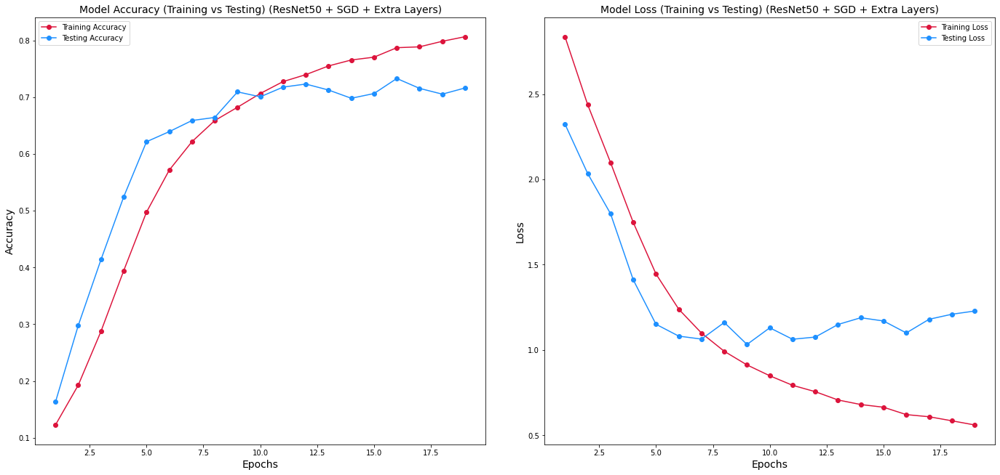

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(resnet50_pretrained.history.history['accuracy']) + 1), resnet50_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(resnet50_pretrained.history.history['val_accuracy']) + 1), resnet50_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (ResNet50 + SGD + Extra Layers)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(resnet50_pretrained.history.history['loss']) + 1), resnet50_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(resnet50_pretrained.history.history['val_loss']) + 1), resnet50_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (ResNet50 + SGD + Extra Layers)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
resnet50_pretrained.load_weights('resnet50_extralayers_augmented.hdf5')
test_image_predictions = resnet50_pretrained.predict(test_images)

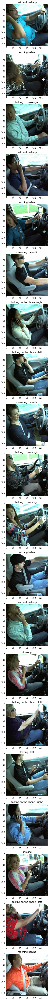

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

## 9. Model 5: Xception + SGD + No Extra Layers

In [ ]:
#Defining the input
xception_input = Input(shape = (150, 150, 3), name='image_input')

#Getting the Xception weights and layers trained on ImageNet
model_xception_convolution = Xception(weights='imagenet', include_top=False, input_tensor=xception_input)
model_xception_convolution.summary()

2022-06-16 16:54:33.421428: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 16:54:33.421837: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 16:54:33.422070: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 16:54:33.422582: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-16 16:54:33.422843: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read f

83697664/83683744 [==============================] - 4s 0us/step
Model: "xception"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 image_input (InputLayer)       [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 74, 74, 32)   864         ['image_input[0][0]']            
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 74, 74, 32)  128         ['block1_conv1[0][0]']           
 ation)                                                                                           
                          

In [ ]:
#Creating the architecture
output_xception_convolution = model_xception_convolution(xception_input)
x = Flatten(name='flatten')(output_xception_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

xception_pretrained = Model(inputs=xception_input, outputs=output)
xception_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.001)
xception_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 xception (Functional)       (None, 5, 5, 2048)        20861480  
                                                                 
 flatten (Flatten)           (None, 51200)             0         
                                                                 
 predictions (Dense)         (None, 10)                512010    
                                                                 
Total params: 21,373,490
Trainable params: 21,318,962
Non-trainable params: 54,528
_________________________________________________________________


In [ ]:
checkpointer = ModelCheckpoint('xception_noextralayers_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range=0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size = 64)

#Fitting the model on batches with real-time data augmentation
xception_model = xception_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper],
                                         epochs=40, verbose=1, validation_data=(X_test, y_test))

Epoch 1/40


2022-06-16 16:54:45.820005: I tensorflow/stream_executor/cuda/cuda_dnn.cc:377] Loaded cuDNN version 8302


308/307 [==============================] - ETA: 0s - loss: 2.2605 - accuracy: 0.1678
Epoch 00001: val_loss improved from inf to 2.16444, saving model to xception_noextralayers_augmented.hdf5


/usr/local/lib/python3.8/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


307/307 [==============================] - 102s 311ms/step - loss: 2.2605 - accuracy: 0.1678 - val_loss: 2.1644 - val_accuracy: 0.2417
Epoch 2/40
308/307 [==============================] - ETA: 0s - loss: 2.0988 - accuracy: 0.2480
Epoch 00002: val_loss improved from 2.16444 to 2.01222, saving model to xception_noextralayers_augmented.hdf5
307/307 [==============================] - 91s 295ms/step - loss: 2.0988 - accuracy: 0.2480 - val_loss: 2.0122 - val_accuracy: 0.3332
Epoch 3/40
308/307 [==============================] - ETA: 0s - loss: 1.9714 - accuracy: 0.3063
Epoch 00003: val_loss improved from 2.01222 to 1.92054, saving model to xception_noextralayers_augmented.hdf5
307/307 [==============================] - 91s 294ms/step - loss: 1.9714 - accuracy: 0.3063 - val_loss: 1.9205 - val_accuracy: 0.3321
Epoch 4/40
308/307 [==============================] - ETA: 0s - loss: 1.8478 - accuracy: 0.3504
Epoch 00004: val_loss improved from 1.92054 to 1.73482, saving model to xception_noextral

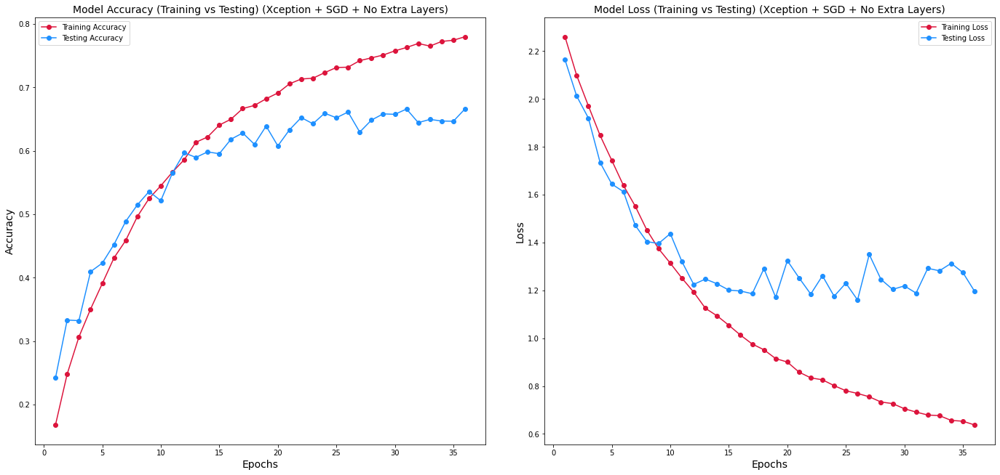

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(xception_pretrained.history.history['accuracy']) + 1), xception_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(xception_pretrained.history.history['val_accuracy']) + 1), xception_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (Xception + SGD + No Extra Layers)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(xception_pretrained.history.history['loss']) + 1), xception_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(xception_pretrained.history.history['val_loss']) + 1), xception_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (Xception + SGD + No Extra Layers)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
xception_pretrained.load_weights('xception_noextralayers_augmented.hdf5')
test_image_predictions = xception_pretrained.predict(test_images)

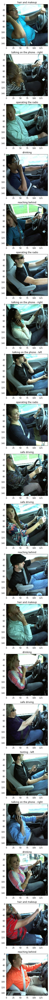

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

## 10. Model 6: Xception + SGD + Extra Layers

In [ ]:
#Defining the input
xception_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the VGG16 weights and layers trained on ImageNet
model_xception_convolution = Xception(weights='imagenet', include_top=False, input_tensor=xception_input)
model_xception_convolution.summary()

Model: "xception"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 image_input (InputLayer)       [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 block1_conv1 (Conv2D)          (None, 74, 74, 32)   864         ['image_input[0][0]']            
                                                                                                  
 block1_conv1_bn (BatchNormaliz  (None, 74, 74, 32)  128         ['block1_conv1[0][0]']           
 ation)                                                                                           
                                                                                           

In [ ]:
#Creating the architecture
output_xception_convolution = model_xception_convolution(xception_input)
x = GlobalAveragePooling2D()(output_xception_convolution)
#Adding these dense layers so that the model can learn more complex functions and classify with better accuracy
x = Dense(1024, activation='relu')(x)
x = Dropout(0.1)(x) 
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
output = Dense(10, activation='softmax', name='predictions')(x)

xception_pretrained = Model(inputs=xception_input, outputs=output)
xception_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.001)
xception_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 xception (Functional)       (None, 5, 5, 2048)        20861480  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 1024)              2098176   
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                                 
 dense_1 (Dense)             (None, 1024)              1049600   
                                                             

In [ ]:
checkpointer = ModelCheckpoint('xception_extralayers_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range=0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size = 64)

#Fitting the model on batches with real-time data augmentation
xception_model = xception_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper],
                                         epochs=40, verbose=1, validation_data=(X_test, y_test))

Epoch 1/40


2022-06-17 05:50:45.909150: I tensorflow/stream_executor/cuda/cuda_dnn.cc:377] Loaded cuDNN version 8302


308/307 [==============================] - ETA: 0s - loss: 2.7492 - accuracy: 0.1102
Epoch 00001: val_loss improved from inf to 2.30506, saving model to xception_extralayers_augmented.hdf5


/usr/local/lib/python3.8/dist-packages/keras/engine/functional.py:1410: CustomMaskWarning: Custom mask layers require a config and must override get_config. When loading, the custom mask layer must be passed to the custom_objects argument.
  layer_config = serialize_layer_fn(layer)


307/307 [==============================] - 101s 304ms/step - loss: 2.7492 - accuracy: 0.1102 - val_loss: 2.3051 - val_accuracy: 0.1361
Epoch 2/40
308/307 [==============================] - ETA: 0s - loss: 2.5593 - accuracy: 0.1281
Epoch 00002: val_loss did not improve from 2.30506
307/307 [==============================] - 90s 291ms/step - loss: 2.5593 - accuracy: 0.1281 - val_loss: 2.3069 - val_accuracy: 0.1503
Epoch 3/40
308/307 [==============================] - ETA: 0s - loss: 2.4531 - accuracy: 0.1463
Epoch 00003: val_loss improved from 2.30506 to 2.26243, saving model to xception_extralayers_augmented.hdf5
307/307 [==============================] - 94s 304ms/step - loss: 2.4531 - accuracy: 0.1463 - val_loss: 2.2624 - val_accuracy: 0.1684
Epoch 4/40
308/307 [==============================] - ETA: 0s - loss: 2.3711 - accuracy: 0.1672
Epoch 00004: val_loss improved from 2.26243 to 2.17767, saving model to xception_extralayers_augmented.hdf5
307/307 [==============================] -

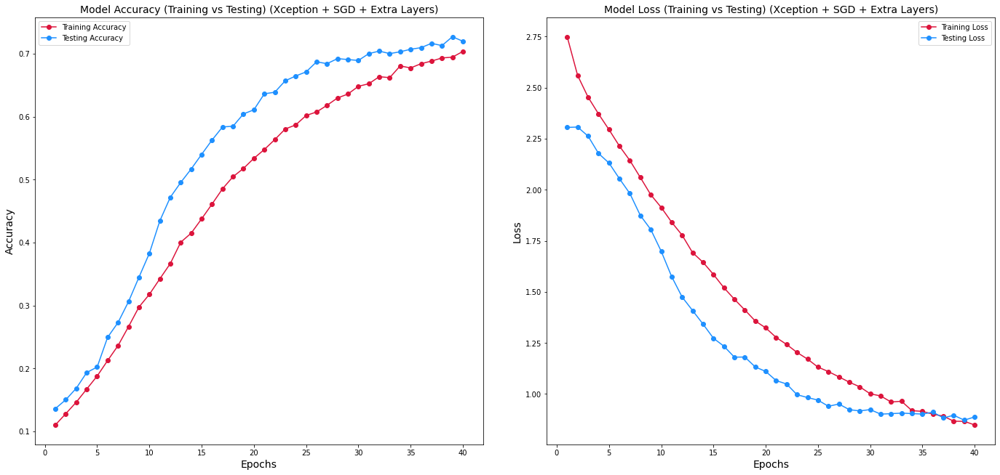

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(xception_pretrained.history.history['accuracy']) + 1), xception_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(xception_pretrained.history.history['val_accuracy']) + 1), xception_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (Xception + SGD + Extra Layers)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(xception_pretrained.history.history['loss']) + 1), xception_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(xception_pretrained.history.history['val_loss']) + 1), xception_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (Xception + SGD + Extra Layers)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
xception_pretrained.load_weights('xception_extralayers_augmented.hdf5')
test_image_predictions = xception_pretrained.predict(test_images)

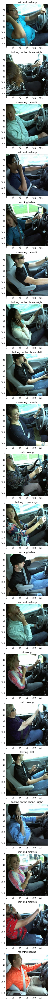

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

## 11. Model 7: MobileNet + SGD + No Extra Layers

In [ ]:
#Defining the input
mobilenet_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the MobileNet weights and layers trained on ImageNet
model_mobilenet_convolution = MobileNet(weights='imagenet', include_top=False, input_tensor=mobilenet_input)
model_mobilenet_convolution.summary()

2022-06-17 07:01:21.050831: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-17 07:01:21.051290: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-17 07:01:21.051534: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-17 07:01:21.052102: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-17 07:01:21.052373: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read f

17235968/17225924 [==============================] - 1s 0us/step
Model: "mobilenet_1.00_224"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 75, 75, 32)        864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 75, 75, 32)       128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 75, 75, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 75, 75, 32)       288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 75, 75, 32) 

In [ ]:
#Creating the architecture
output_mobilenet_convolution = model_mobilenet_convolution(mobilenet_input)
x = GlobalAveragePooling2D()(output_mobilenet_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

mobilenet_pretrained = Model(inputs=mobilenet_input, outputs=output)
mobilenet_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.005)
mobilenet_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 mobilenet_1.00_224 (Functio  (None, 4, 4, 1024)       3228864   
 nal)                                                            
                                                                 
 global_average_pooling2d (G  (None, 1024)             0         
 lobalAveragePooling2D)                                          
                                                                 
 predictions (Dense)         (None, 10)                10250     
                                                                 
Total params: 3,239,114
Trainable params: 3,217,226
Non-trainable params: 21,888
_________________________________________________________________


In [ ]:
checkpointer = ModelCheckpoint('mobilenet_noextralayers_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range=0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size = 64)

#Fitting the model on batches with real-time data augmentation
mobilenet_model = mobilenet_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper],
                                           epochs=25, verbose=1, validation_data=(X_test, y_test))

Epoch 1/25


2022-06-17 07:01:28.970613: I tensorflow/stream_executor/cuda/cuda_dnn.cc:377] Loaded cuDNN version 8302


308/307 [==============================] - ETA: 0s - loss: 1.8668 - accuracy: 0.3684
Epoch 00001: val_loss improved from inf to 1.21265, saving model to mobilenet_noextralayers_augmented.hdf5
307/307 [==============================] - 90s 277ms/step - loss: 1.8668 - accuracy: 0.3684 - val_loss: 1.2127 - val_accuracy: 0.5989
Epoch 2/25
308/307 [==============================] - ETA: 0s - loss: 1.0963 - accuracy: 0.6251
Epoch 00002: val_loss improved from 1.21265 to 0.90795, saving model to mobilenet_noextralayers_augmented.hdf5
307/307 [==============================] - 85s 277ms/step - loss: 1.0963 - accuracy: 0.6251 - val_loss: 0.9080 - val_accuracy: 0.7103
Epoch 3/25
308/307 [==============================] - ETA: 0s - loss: 0.8754 - accuracy: 0.7008
Epoch 00003: val_loss did not improve from 0.90795
307/307 [==============================] - 84s 272ms/step - loss: 0.8754 - accuracy: 0.7008 - val_loss: 0.9774 - val_accuracy: 0.7238
Epoch 4/25
308/307 [==============================] 

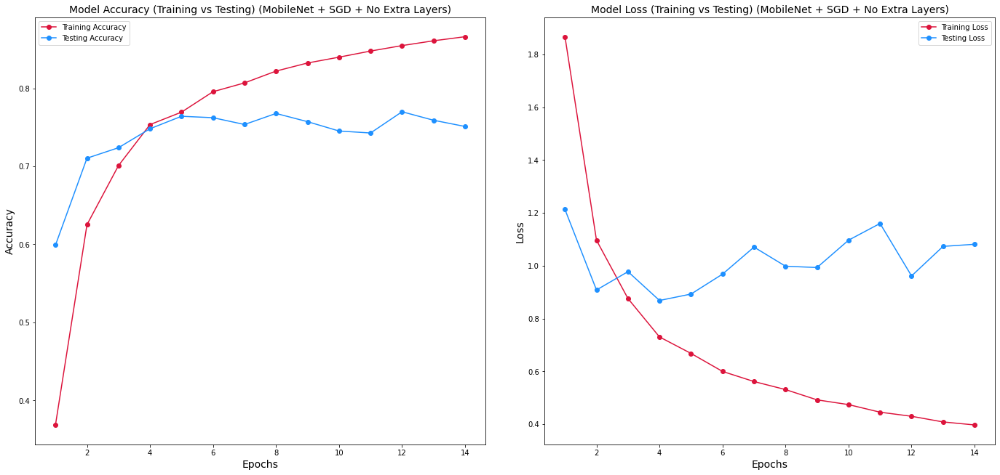

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(mobilenet_pretrained.history.history['accuracy']) + 1), mobilenet_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(mobilenet_pretrained.history.history['val_accuracy']) + 1), mobilenet_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (MobileNet + SGD + No Extra Layers)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(mobilenet_pretrained.history.history['loss']) + 1), mobilenet_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(mobilenet_pretrained.history.history['val_loss']) + 1), mobilenet_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (MobileNet + SGD + No Extra Layers)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
mobilenet_pretrained.load_weights('mobilenet_noextralayers_augmented.hdf5')
test_image_predictions = mobilenet_pretrained.predict(test_images)

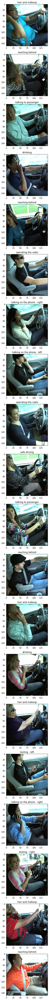

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

## 12. Model 8: MobileNet + SGD + Extra Layers

In [ ]:
#Defining the input
mobilenet_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the MobileNet weights and layers trained on ImageNet
model_mobilenet_convolution = MobileNet(weights='imagenet', include_top=False, input_tensor=mobilenet_input)
model_mobilenet_convolution.summary()

2022-06-17 09:32:58.758040: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-17 09:32:58.758441: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-17 09:32:58.758679: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-17 09:32:58.759208: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-06-17 09:32:58.759478: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:1052] successful NUMA node read f

17235968/17225924 [==============================] - 1s 0us/step
Model: "mobilenet_1.00_224"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 75, 75, 32)        864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 75, 75, 32)       128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 75, 75, 32)        0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 75, 75, 32)       288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 75, 75, 32) 

In [ ]:
#Creating the architecture
output_mobilenet_convolution = model_mobilenet_convolution(mobilenet_input)
x = GlobalAveragePooling2D()(output_mobilenet_convolution)
#Adding these dense layers so that the model can learn more complex functions and classify with better accuracy
x = Dense(1024, activation='relu')(x)
x = Dropout(0.1)(x) 
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
output = Dense(10, activation='softmax')(x)

mobilenet_pretrained = Model(inputs=mobilenet_input, outputs=output)
mobilenet_pretrained.summary()

#Compiling the CNN model
SGD = optimizers.SGD(learning_rate=0.001)
mobilenet_pretrained.compile(optimizer=SGD, loss='categorical_crossentropy', metrics=['accuracy'])

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 image_input (InputLayer)    [(None, 150, 150, 3)]     0         
                                                                 
 mobilenet_1.00_224 (Functio  (None, 4, 4, 1024)       3228864   
 nal)                                                            
                                                                 
 global_average_pooling2d_1   (None, 1024)             0         
 (GlobalAveragePooling2D)                                        
                                                                 
 dense_4 (Dense)             (None, 1024)              1049600   
                                                                 
 dropout_2 (Dropout)         (None, 1024)              0         
                                                                 
 dense_5 (Dense)             (None, 1024)              1049

In [ ]:
checkpointer = ModelCheckpoint('mobilenet_extralayers_augmented.hdf5', verbose=1, save_best_only=True)
earlystopper = EarlyStopping(monitor='val_loss', patience=10, verbose=1)

#Using Data Augmentation
datagen = ImageDataGenerator(
    height_shift_range=0.5,
    width_shift_range=0.5,
    zoom_range=0.5,
    rotation_range=30
)
data_generator = datagen.flow(X_train, y_train, batch_size = 64)

#Fitting the model on batches with real-time data augmentation
mobilenet_model = mobilenet_pretrained.fit(data_generator, steps_per_epoch=len(X_train)/64, callbacks=[checkpointer, earlystopper],
                                           epochs=25, verbose=1, validation_data=(X_test, y_test))

Epoch 1/25


2022-06-17 09:36:16.776798: I tensorflow/stream_executor/cuda/cuda_dnn.cc:377] Loaded cuDNN version 8302


308/307 [==============================] - ETA: 0s - loss: 2.8504 - accuracy: 0.1226
Epoch 00001: val_loss improved from inf to 2.14535, saving model to mobilenet_extralayers_augmented.hdf5
307/307 [==============================] - 88s 271ms/step - loss: 2.8504 - accuracy: 0.1226 - val_loss: 2.1453 - val_accuracy: 0.2309
Epoch 2/25
308/307 [==============================] - ETA: 0s - loss: 2.5224 - accuracy: 0.1802
Epoch 00002: val_loss improved from 2.14535 to 1.79868, saving model to mobilenet_extralayers_augmented.hdf5
307/307 [==============================] - 82s 267ms/step - loss: 2.5224 - accuracy: 0.1802 - val_loss: 1.7987 - val_accuracy: 0.3666
Epoch 3/25
308/307 [==============================] - ETA: 0s - loss: 2.2588 - accuracy: 0.2444
Epoch 00003: val_loss improved from 1.79868 to 1.46838, saving model to mobilenet_extralayers_augmented.hdf5
307/307 [==============================] - 82s 268ms/step - loss: 2.2588 - accuracy: 0.2444 - val_loss: 1.4684 - val_accuracy: 0.474

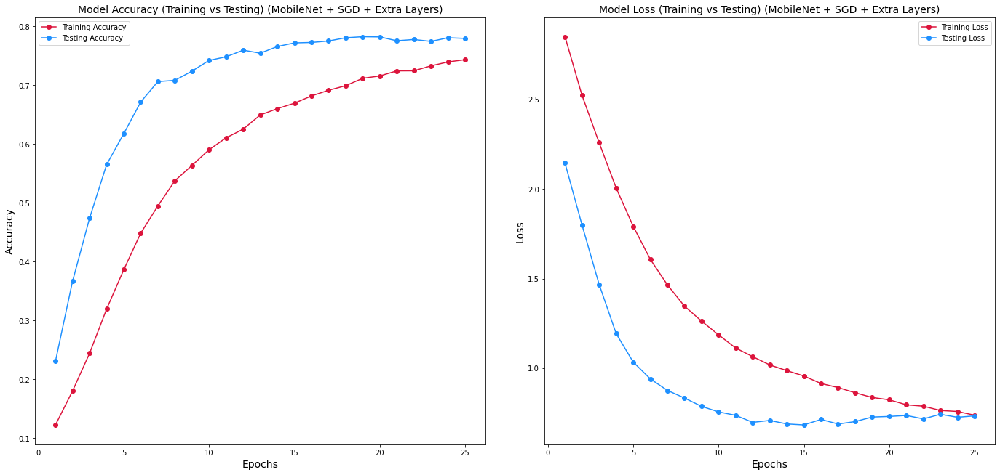

In [ ]:
#Plotting graphs
fig, ax = plt.subplots(1, 2, figsize = (20, 10))

#First plot
ax[0].plot(range(1, len(mobilenet_pretrained.history.history['accuracy']) + 1), mobilenet_pretrained.history.history['accuracy'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Accuracy')
ax[0].plot(range(1, len(mobilenet_pretrained.history.history['val_accuracy']) + 1), mobilenet_pretrained.history.history['val_accuracy'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Accuracy')
ax[0].set_xlabel('Epochs', fontsize = 14)
ax[0].set_ylabel('Accuracy',fontsize = 14)
ax[0].set_title('Model Accuracy (Training vs Testing) (MobileNet + SGD + Extra Layers)', fontsize=14)
ax[0].legend(loc = 'best')

#Second plot
ax[1].plot(range(1, len(mobilenet_pretrained.history.history['loss']) + 1), mobilenet_pretrained.history.history['loss'], linestyle = 'solid', marker = 'o', color = 'crimson', label = 'Training Loss')
ax[1].plot(range(1, len(mobilenet_pretrained.history.history['val_loss']) + 1), mobilenet_pretrained.history.history['val_loss'], linestyle = 'solid', marker = 'o', color = 'dodgerblue', label = 'Testing Loss')
ax[1].set_xlabel('Epochs', fontsize = 14)
ax[1].set_ylabel('Loss', fontsize = 14)
ax[1].set_title('Model Loss (Training vs Testing) (MobileNet + SGD + Extra Layers)', fontsize=14)
ax[1].legend(loc='best')

plt.tight_layout(pad=4)
plt.show()

In [ ]:
#Testing the model on test images
mobilenet_pretrained.load_weights('mobilenet_extralayers_augmented.hdf5')
test_image_predictions = mobilenet_pretrained.predict(test_images)

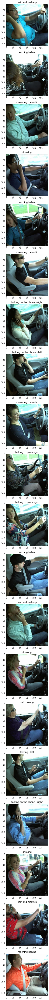

In [ ]:
#Plotting the predictions by the model on test images
fig, ax = plt.subplots(20, 1, figsize=(6.4*1, 4.8*20))

for i in range(20):
    ax[i].imshow(test_images[i].squeeze())
    predicted_class = np.argmax(test_image_predictions[i])
    ax[i].set_title(classes[predicted_class])
plt.show()

## 13. Loading the 8 models and showing statistics

### 1. VGG16 + SGD + No Extra Layers

In [ ]:
#Defining the input
vgg16_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the VGG16 weights and layers trained on ImageNet
model_vgg16_convolution = VGG16(weights='imagenet', include_top=False, input_tensor=vgg16_input)

#Creating the architecture
output_vgg16_convolution = model_vgg16_convolution(vgg16_input)
x = Flatten(name='flatten')(output_vgg16_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

model1 = Model(inputs=vgg16_input, outputs=output)
model1.load_weights('vgg16_noextralayers_augmented.hdf5')

58900480/58889256 [==============================] - 3s 0us/step


In [ ]:
y_pred_probabilities_1 = model1.predict(X_test)
y_preds_1 = []
for i in range(len(y_pred_probabilities_1)):
    y_preds_1.append(np.argmax(y_pred_probabilities_1[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_1), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, y_pred_probabilities_1), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_1), sep ='')

Number of images in validation set:
2755

Accuracy:
0.7495462794918331

Log Loss:
1.075838385424733

Confusion Matrix:
[[258   0   0   4   3  21   1   0   0  15]
 [ 16 264   0   1   5   0   0   0  10   6]
 [  0   0 269   0   0   0   2   0  20   0]
 [  7   0   0 267   2   1   0   0   0  10]
 [ 22   0   0  19 176   2   0   0  54  25]
 [  0   0   0   0   0 264   0   0   0   0]
 [  0  29   7   0   0   0 218   0  43   0]
 [  0   0   0   0   0   0   1 113 114   6]
 [ 12   0   4   0   3   0  60   0 152   1]
 [ 79   0   0  28   4  52   0   0   1  84]]


### 2. VGG16 + SGD + Extra Layers

In [ ]:
#Defining the input
vgg16_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the VGG16 weights and layers trained on ImageNet
model_vgg16_convolution = VGG16(weights='imagenet', include_top=False, input_tensor=vgg16_input)

#Creating the architecture
output_vgg16_convolution = model_vgg16_convolution(vgg16_input)
x = GlobalAveragePooling2D()(output_vgg16_convolution)
#Adding these dense layers so that the model can learn more complex functions and classify with better accuracy
x = Dense(1024, activation='relu')(x) 
x = Dropout(0.1)(x) 
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
output = Dense(10, activation='softmax', name='predictions')(x)

model2 = Model(inputs=vgg16_input, outputs=output)
model2.load_weights('vgg16_extralayers_augmented.hdf5')

In [ ]:
y_pred_probabilities_2 = model2.predict(X_test)
y_preds_2 = []
for i in range(len(y_pred_probabilities_2)):
    y_preds_2.append(np.argmax(y_pred_probabilities_2[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_2), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, y_pred_probabilities_2), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_2), sep ='')

Number of images in validation set:
2755

Accuracy:
0.7651542649727767

Log Loss:
0.7138804961393083

Confusion Matrix:
[[212   1   2   0   2   4   0   0   5  76]
 [  5 284   0   0   4   0   0   0   4   5]
 [  0   0 263   0   0   0   1   0  27   0]
 [  6   0   0 254   2   0   0   0   0  25]
 [  2  21   1   2 207   1   0   0  32  32]
 [  3   0   0   0   0 259   0   0   0   2]
 [  0  37  54   0   0   0 168  13  24   1]
 [  0   0   1   0   0   0   0 192  41   0]
 [  5   2  67   0   0   2  48   2 101   5]
 [ 61   0   0   0   5  13   0   1   0 168]]


### 3. ResNet50 + SGD + No Extra Layers

In [ ]:
#Defining the input
resnet50_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the ResNet50 weights and layers trained on ImageNet
model_resnet50_convolution = ResNet50(weights='imagenet', include_top=False, input_tensor=resnet50_input)

#Creating the architecture
output_resnet50_convolution = model_resnet50_convolution(resnet50_input)
x = Flatten(name='flatten')(output_resnet50_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

model3 = Model(inputs=resnet50_input, outputs=output)
model3.load_weights('resnet50_noextralayers_augmented.hdf5')

94781440/94765736 [==============================] - 4s 0us/step


In [ ]:
y_pred_probabilities_3 = model3.predict(X_test)
y_preds_3 = []
for i in range(len(y_pred_probabilities_3)):
    y_preds_3.append(np.argmax(y_pred_probabilities_3[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_3), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, y_pred_probabilities_3), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_3), sep ='')

Number of images in validation set:
2755

Accuracy:
0.6929219600725953

Log Loss:
1.2845102738017018

Confusion Matrix:
[[221   0   1   3   7  21   0   2  37  10]
 [ 15 225   0   1   3   1  10   0  47   0]
 [  0   0 212   0   0   0   1   0  78   0]
 [  2   0   0 247   0  30   0   0   6   2]
 [  2   0   0   4 164   3   0   2 112  11]
 [  1   0   0   0   0 263   0   0   0   0]
 [  0  31   0   0   0   1 147   1 115   2]
 [  2   1   0   0   0  23   0 148  59   1]
 [  3   0   0   0   1   1  24   0 203   0]
 [ 79   0   0   1   1  57   0   6  25  79]]


### 4. ResNet50 + SGD + Extra Layers

In [ ]:
#Defining the input
resnet50_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the ResNet50 weights and layers trained on ImageNet
model_resnet50_convolution = ResNet50(weights='imagenet', include_top=False, input_tensor=resnet50_input)

#Creating the architecture
output_resnet50_convolution = model_resnet50_convolution(resnet50_input)
x = GlobalAveragePooling2D()(output_resnet50_convolution)
#Adding these dense layers so that the model can learn more complex functions and classify with better accuracy
x = Dense(1024, activation='relu')(x)
x = Dropout(0.1)(x)
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
output = Dense(10, activation='softmax', name='predictions')(x)

model4 = Model(inputs=resnet50_input, outputs=output)
model4.load_weights('resnet50_extralayers_augmented.hdf5')

In [ ]:
y_pred_probabilities_4 = model4.predict(X_test)
y_preds_4 = []
for i in range(len(y_pred_probabilities_4)):
    y_preds_4.append(np.argmax(y_pred_probabilities_4[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_4), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, y_pred_probabilities_4), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_4), sep ='')

Number of images in validation set:
2755

Accuracy:
0.7092558983666062

Log Loss:
1.0321295161629447

Confusion Matrix:
[[180   4   1  48   3  50   0   1   6   9]
 [  0 238   0   5   1   0   1   2  52   3]
 [  0   0 285   0   0   0   1   0   5   0]
 [  1   0   0 261  22   1   0   0   2   0]
 [  6   0   0  27 145  17   0   0  87  16]
 [  3   0   0   0   0 260   0   0   0   1]
 [  0  10  11   0   0   0 150   0 125   1]
 [  0   0   0   0   0   5   0 184  36   9]
 [  2   2  24   0   0   4  40   0 159   1]
 [ 65   2   0   9   1  55   0  14  10  92]]


### 5. Xception + SGD + No Extra Layers

In [ ]:
#Defining the input
xception_input = Input(shape = (150, 150, 3), name='image_input')

#Getting the Xception weights and layers trained on ImageNet
model_xception_convolution = Xception(weights='imagenet', include_top=False, input_tensor=xception_input)

#Creating the architecture
output_xception_convolution = model_xception_convolution(xception_input)
x = Flatten(name='flatten')(output_xception_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

model5 = Model(inputs=xception_input, outputs=output)
model5.load_weights('xception_noextralayers_augmented.hdf5')

83697664/83683744 [==============================] - 4s 0us/step


In [ ]:
y_pred_probabilities_5 = model5.predict(X_test)
y_preds_5 = []
for i in range(len(y_pred_probabilities_5)):
    y_preds_5.append(np.argmax(y_pred_probabilities_5[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_5), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, y_pred_probabilities_5), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_5), sep ='')

Number of images in validation set:
2755

Accuracy:
0.6609800362976407

Log Loss:
1.160157381225972

Confusion Matrix:
[[207   0   5   7   4   4   0   1  49  25]
 [ 34 173  18   2   0   2   7   0  60   6]
 [  0   0 151   0   0   0   1   0 139   0]
 [  1   0   1 279   0   1   0   0   4   1]
 [ 32   0   8   7 155  14   1   1  50  30]
 [  5   0   0   0   0 258   0   0   1   0]
 [  0   4  29   0   0   9 193   5  57   0]
 [  6   0   3   0   0  13   0 131  78   3]
 [  3   1  15   0   1   2  32   3 166   9]
 [ 71   0   0   2   1  32   0  11  23 108]]


### 6. Xception + SGD + Extra Layers

In [ ]:
#Defining the input
xception_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the VGG16 weights and layers trained on ImageNet
model_xception_convolution = Xception(weights='imagenet', include_top=False, input_tensor=xception_input)

#Creating the architecture
output_xception_convolution = model_xception_convolution(xception_input)
x = GlobalAveragePooling2D()(output_xception_convolution)
#Adding these dense layers so that the model can learn more complex functions and classify with better accuracy
x = Dense(1024, activation='relu')(x)
x = Dropout(0.1)(x) 
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
output = Dense(10, activation='softmax', name='predictions')(x)

model6 = Model(inputs=xception_input, outputs=output)
model6.load_weights('xception_extralayers_augmented.hdf5')

In [ ]:
y_pred_probabilities_6 = model6.predict(X_test)
y_preds_6 = []
for i in range(len(y_pred_probabilities_6)):
    y_preds_6.append(np.argmax(y_pred_probabilities_6[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_6), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, y_pred_probabilities_6), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_6), sep ='')

Number of images in validation set:
2755

Accuracy:
0.7270417422867513

Log Loss:
0.8719877123482658

Confusion Matrix:
[[195   0   5  43   7   2   0   0   9  41]
 [ 15 219   7   7   0   0   3   1  44   6]
 [  0   0 188   0   0   0   1   0 102   0]
 [  1   0   0 284   1   0   0   0   1   0]
 [ 30   0   4  16 162   2   0   2  59  23]
 [  4   0   0   0   0 260   0   0   0   0]
 [  0   9  22   0   0   0 209   1  55   1]
 [  2   0   1   0   0   0   0 193  32   6]
 [  3   2  12   0   1   0  34   1 172   7]
 [ 61   0   0   4   5  20   0  11  26 121]]


### 7. MobileNet + SGD + No Extra Layers

In [ ]:
#Defining the input
mobilenet_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the MobileNet weights and layers trained on ImageNet
model_mobilenet_convolution = MobileNet(weights='imagenet', include_top=False, input_tensor=mobilenet_input)

#Creating the architecture
output_mobilenet_convolution = model_mobilenet_convolution(mobilenet_input)
x = GlobalAveragePooling2D()(output_mobilenet_convolution)
output = Dense(10, activation='softmax', name='predictions')(x)

model7 = Model(inputs=mobilenet_input, outputs=output)
model7.load_weights('mobilenet_noextralayers_augmented.hdf5')

17235968/17225924 [==============================] - 1s 0us/step


In [ ]:
y_pred_probabilities_7 = model7.predict(X_test)
y_preds_7 = []
for i in range(len(y_pred_probabilities_7)):
    y_preds_7.append(np.argmax(y_pred_probabilities_7[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_7), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, y_pred_probabilities_7), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_7), sep ='')

Number of images in validation set:
2755

Accuracy:
0.7480943738656988

Log Loss:
0.8682380862104402

Confusion Matrix:
[[211   1   0  13   0  11   0   0  47  19]
 [  1 213   0   1   0   0   1   0  71  15]
 [  0   0 249   0   0   0   1   0  41   0]
 [  0   0   0 276   0   1   0   0  10   0]
 [ 36   0   0  13 146   3   0   1  93   6]
 [  0   0   0   1   0 251   0   0   4   8]
 [  0  10  21   0   0   0 187   0  79   0]
 [  0   0   0   0   0   0   0 228   5   1]
 [  3   1   5   0   0   0  39   3 178   3]
 [ 72   0   0   1   1  12   0   0  40 122]]


### 8. MobileNet + SGD + Extra Layers

In [ ]:
#Defining the input
mobilenet_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the MobileNet weights and layers trained on ImageNet
model_mobilenet_convolution = MobileNet(weights='imagenet', include_top=False, input_tensor=mobilenet_input)

#Creating the architecture
output_mobilenet_convolution = model_mobilenet_convolution(mobilenet_input)
x = GlobalAveragePooling2D()(output_mobilenet_convolution)
#Adding these dense layers so that the model can learn more complex functions and classify with better accuracy
x = Dense(1024, activation='relu')(x)
x = Dropout(0.1)(x) 
x = Dense(1024, activation='relu')(x)
x = BatchNormalization()(x)
x = Dropout(0.5)(x)
x = Dense(512, activation='relu')(x)
output = Dense(10, activation='softmax')(x)

model8 = Model(inputs=mobilenet_input, outputs=output)
model8.load_weights('mobilenet_extralayers_augmented.hdf5')

In [ ]:
y_pred_probabilities_8 = model8.predict(X_test)
y_preds_8 = []
for i in range(len(y_pred_probabilities_8)):
    y_preds_8.append(np.argmax(y_pred_probabilities_8[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_8), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, y_pred_probabilities_8), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_8), sep ='')

Number of images in validation set:
2755

Accuracy:
0.7716878402903812

Log Loss:
0.6839520515671508

Confusion Matrix:
[[202   1   0  41  14   3   0   0  24  17]
 [  6 227   0   2   0   0   3   0  62   2]
 [  0   0 261   0   0   0  14   0  16   0]
 [  0   0   0 286   1   0   0   0   0   0]
 [ 17   1   0  20 192   3   0   2  53  10]
 [  5   0   0   1   1 243   0   0   0  14]
 [  0  21   5   0   0   0 173   0  98   0]
 [  0   0   0   0   0   1   0 231   2   0]
 [  4   2  13   0   1   1  56   6 147   2]
 [ 57   0   0   2   3   8   0   0  14 164]]


## 14. Ensembling the models (Validation Set)

### 1. Mean Ensembling

In [ ]:
mean_ensemble_pred_probabilities = []
#Getting hold of one image
for i in range(len(X_test)):
    classwise_pred_probabilities = []
    classwise_mean_pred_probabilities = [] 
    #Getting hold of a class
    for j in range(10):
        #Storing the predicted proababilities by the models 1-8, for a specific image i and a specific class j
        #classwise_pred_probabilities.append(y_pred_probabilities_1[i][j])
        classwise_pred_probabilities.append(y_pred_probabilities_2[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_3[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_4[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_5[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_6[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_7[i][j])
        classwise_pred_probabilities.append(y_pred_probabilities_8[i][j])
        
        #Calculating the mean of the probabilities of a particular class j
        classwise_mean_pred_probabilities.append(mean(classwise_pred_probabilities))
    
    #Storing the trimmed mean probabilities of all classes for a particular image i
    classwise_mean_pred_probabilities = np.asarray(classwise_mean_pred_probabilities)
    #Finally appending the ensemble predicted probabilities for a particular image i 
    mean_ensemble_pred_probabilities.append(classwise_mean_pred_probabilities)
        
mean_ensemble_pred_probabilities = np.asarray(mean_ensemble_pred_probabilities)        

In [ ]:
y_preds_mean_ensemble = []
for i in range(len(mean_ensemble_pred_probabilities)):
    y_preds_mean_ensemble.append(np.argmax(mean_ensemble_pred_probabilities[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_mean_ensemble), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, mean_ensemble_pred_probabilities), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_mean_ensemble), sep ='')

Number of images in validation set:
2755

Accuracy:
0.7480943738656988

Log Loss:
1.5358584298135312

Confusion Matrix:
[[272   1   0  17   1   1   0   0   1   9]
 [  7 288   0   0   0   0   0   0   7   0]
 [  0   0 285   0   0   0   1   0   5   0]
 [  6   0   0 280   1   0   0   0   0   0]
 [ 35  31   0   4 205   9   0   0   2  12]
 [ 13   0   0   0   0 246   0   0   0   5]
 [  0  39  25   0   0   0 129   0 103   1]
 [  0   0   1   0   0   0   0 109 124   0]
 [  9   3  44   0   0   0  46   0 120  10]
 [114   1   0   0   2   4   0   0   0 127]]


### 2. Trimmed Mean Ensembling

In [ ]:
trimmed_mean_ensemble_pred_probabilities = []
#Getting hold of one image
for i in range(len(X_test)):
    classwise_pred_probabilities = []
    classwise_mean_pred_probabilities = [] 
    #Getting hold of a class
    for j in range(10):
        #Storing the predicted proababilities by the models 1-8, for a specific image i and a specific class j
        classwise_pred_probabilities.append(y_pred_probabilities_1[i][j])
        classwise_pred_probabilities.append(y_pred_probabilities_2[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_3[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_4[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_5[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_6[i][j])
        classwise_pred_probabilities.append(y_pred_probabilities_7[i][j])
        classwise_pred_probabilities.append(y_pred_probabilities_8[i][j])
        
        #Calculating the trimmed mean of the probabilities of a particular class j
        trimmed_mean = (sum(classwise_pred_probabilities) - max(classwise_pred_probabilities) - min(classwise_pred_probabilities))/(len(classwise_pred_probabilities) - 2)
        classwise_mean_pred_probabilities.append(trimmed_mean)
    
    #Storing the trimmed mean probabilities of all classes for a particular image i
    classwise_mean_pred_probabilities = np.asarray(classwise_mean_pred_probabilities)
    #So that the trimmed mean probabilities come between 0-1
    classwise_mean_pred_probabilities = classwise_mean_pred_probabilities/sum(classwise_mean_pred_probabilities)
    #Finally appending the ensemble predicted probabilities for a particular image i 
    trimmed_mean_ensemble_pred_probabilities.append(classwise_mean_pred_probabilities)
        
trimmed_mean_ensemble_pred_probabilities = np.asarray(trimmed_mean_ensemble_pred_probabilities)   

In [ ]:
y_preds_trimmed_mean_ensemble = []
for i in range(len(trimmed_mean_ensemble_pred_probabilities)):
    y_preds_trimmed_mean_ensemble.append(np.argmax(trimmed_mean_ensemble_pred_probabilities[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, y_preds_trimmed_mean_ensemble), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, trimmed_mean_ensemble_pred_probabilities), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, y_preds_trimmed_mean_ensemble), sep ='')

Number of images in validation set:
2755

Accuracy:
0.7332123411978222

Log Loss:
1.4603852187468296

Confusion Matrix:
[[285   0   0   5   0   0   0   0   1  11]
 [ 12 273   0   0   0   0   0   0  17   0]
 [  0   0 277   0   0   0   0   0  14   0]
 [  5   0   0 277   1   1   0   0   0   3]
 [ 76   0   0   0 174   5   0   0  11  32]
 [  6   0   0   0   0 252   0   0   0   6]
 [  0  33  11   0   0   0 133   0 119   1]
 [  0   0   0   0   0   0   0  61 160  13]
 [  8   2  10   0   0   0  34   0 171   7]
 [122   0   0   0   2   7   0   0   0 117]]


### 3. KNN Ensembling

In [ ]:
#Defining the input
vgg16_input = Input(shape = (150, 150, 3), name = 'image_input')

#Getting the VGG16 weights and layers trained on ImageNet
model_vgg16_convolution = VGG16(weights='imagenet', include_top=False, input_tensor=vgg16_input)

In [ ]:
#Passing the test (validation) images through the VGG16 model
vgg16_features_output = model_vgg16_convolution.predict(X_test)
print(vgg16_features_output.shape)
#Flattening the images
input_to_knn = np.reshape(vgg16_features_output, (vgg16_features_output.shape[0], -1))
print(input_to_knn.shape)

(2755, 4, 4, 512)
(2755, 8192)


In [ ]:
#Using unsupervised nearest neighbors, fit on the output of the VGG16 model applied on the test (validation) images
alg = NearestNeighbors(n_neighbors=10).fit(input_to_knn)
#Finding the 10 nearest neighbors to each test (validation) image
#Distances store the distances to all the 10 nearest neighbors of a particular image
#Indices store the indices of all the 10 nearest neighbors of a particular image
distances, indices = alg.kneighbors(input_to_knn)

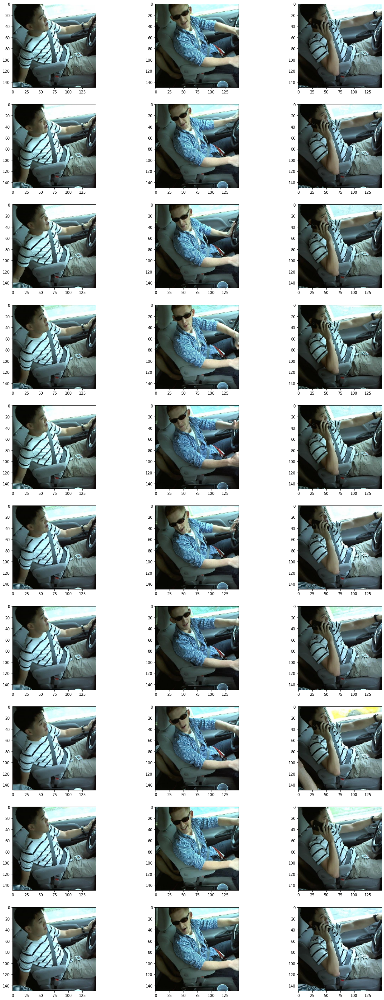

In [ ]:
#Plotting the 10 nearest neighbors of a particular image
fig, ax = plt.subplots(10, 3, figsize = (6.4*3, 4.8*10))

for i in range(3):
    for j in range(10):  
        ax[j][i].imshow(X_test[indices[i*100][j]])
plt.show()

In [ ]:
knn_ensemble_pred_probabilities = []

for i in range(len(X_test)):
    classwise_mean_pred_probabilities = []
    for j in range(10):
        classwise_pred_probabilities = []
        for image in indices[i]:
            classwise_pred_probabilities.append(mean_ensemble_pred_probabilities[image][j])
    
        classwise_mean_pred_probabilities.append(mean(classwise_pred_probabilities))
    
    classwise_mean_pred_probabilities = np.asarray(classwise_mean_pred_probabilities)
    knn_ensemble_pred_probabilities.append(classwise_mean_pred_probabilities)

knn_ensemble_pred_probabilities = np.asarray(knn_ensemble_pred_probabilities)    

In [ ]:
knn_ensemble_preds = []
for i in range(len(X_test)):
    knn_ensemble_preds.append(np.argmax(knn_ensemble_pred_probabilities[i]))

In [ ]:
print('Number of images in validation set:\n', len(y_test), sep='')
print('\nAccuracy:\n', accuracy_score(y_test_true, knn_ensemble_preds), sep ='')
print('\nLog Loss:\n', log_loss(y_test_true, knn_ensemble_pred_probabilities), sep ='')
print('\nConfusion Matrix:\n', confusion_matrix(y_test_true, knn_ensemble_preds), sep ='')

Number of images in validation set:
2755

Accuracy:
0.7684210526315789

Log Loss:
1.5506082017711633

Confusion Matrix:
[[281   1   0  16   0   0   0   0   1   3]
 [  5 297   0   0   0   0   0   0   0   0]
 [  0   0 290   0   0   0   1   0   0   0]
 [  3   0   0 283   1   0   0   0   0   0]
 [ 23  44   0   0 219  11   0   0   0   1]
 [  2   0   0   0   0 260   2   0   0   0]
 [  0  49  15   0   0   0 129   1 103   0]
 [  1   0   0   0   0   0   0 111 120   2]
 [  6   7  43   2   0   0  40   0 132   2]
 [132   0   0   0   0   1   0   0   0 115]]


## 15. Ensembling the models (Test Set)

In [ ]:
images = sorted(os.listdir('data/imgs/test'))

k = 0
l = 0

X_test_actual = []
for i in range(len(images)):
    image = 'data/imgs/test' + '/' + images[i]
    image = cv2.imread(image)
    image = image[50:, 120:-50]
    image = cv2.resize(image, (150, 150))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    X_test_actual.append(image)    
    k += 1
    if k == 1000:
        l += 1
        print('Number of images read:', l*1000)
        k = 0

Number of images read: 1000
Number of images read: 2000
Number of images read: 3000
Number of images read: 4000
Number of images read: 5000
Number of images read: 6000
Number of images read: 7000
Number of images read: 8000
Number of images read: 9000
Number of images read: 10000
Number of images read: 11000
Number of images read: 12000
Number of images read: 13000
Number of images read: 14000
Number of images read: 15000
Number of images read: 16000
Number of images read: 17000
Number of images read: 18000
Number of images read: 19000
Number of images read: 20000
Number of images read: 21000
Number of images read: 22000
Number of images read: 23000
Number of images read: 24000
Number of images read: 25000
Number of images read: 26000
Number of images read: 27000
Number of images read: 28000
Number of images read: 29000
Number of images read: 30000
Number of images read: 31000
Number of images read: 32000
Number of images read: 33000
Number of images read: 34000
Number of images read: 

In [ ]:
#Converting the images to numpy arrays
X_test_actual = np.array(X_test_actual).reshape(-1, 150, 150, 3)
print(X_test_actual.shape)

(79726, 150, 150, 3)


In [ ]:
#Using the 8 models to get the predictions on the test images
#y_pred_probabilities_1 = model1.predict(X_test_actual) #Accuracy: 0.7495462794918331, Log Loss: 1.075838129286237
y_pred_probabilities_2 = model2.predict(X_test_actual)  #Accuracy: 0.7651542649727767, Log Loss: 0.7138804454550245
#y_pred_probabilities_3 = model3.predict(X_test_actual) #Accuracy: 0.6929219600725953, Log Loss: 1.2845102019069954
#y_pred_probabilities_4 = model4.predict(X_test_actual) #Accuracy: 0.7092558983666062, Log Loss: 1.0321294562962597
#y_pred_probabilities_5 = model5.predict(X_test_actual) #Accuracy: 0.6609800362976407, Log Loss: 1.160157381225972
#y_pred_probabilities_6 = model6.predict(X_test_actual) #Accuracy: 0.7270417422867513, Log Loss: 0.8719877123482658
#y_pred_probabilities_7 = model7.predict(X_test_actual) #Accuracy: 0.7480943738656988, Log Loss: 0.8682380862104402
y_pred_probabilities_8 = model8.predict(X_test_actual)  #Accuracy: 0.7716878402903812, Log Loss: 0.6839520515671508

2022-06-21 10:53:22.298950: W tensorflow/core/framework/cpu_allocator_impl.cc:82] Allocation of 5381505000 exceeds 10% of free system memory.
2022-06-21 10:53:27.350471: W tensorflow/core/framework/cpu_allocator_impl.cc:82] Allocation of 5381505000 exceeds 10% of free system memory.
2022-06-21 10:55:29.046913: W tensorflow/core/framework/cpu_allocator_impl.cc:82] Allocation of 5381505000 exceeds 10% of free system memory.
2022-06-21 10:55:34.395050: W tensorflow/core/framework/cpu_allocator_impl.cc:82] Allocation of 5381505000 exceeds 10% of free system memory.


In [ ]:
mean_ensemble_pred_probabilities = []
#Getting hold of one image
for i in range(len(X_test_actual)):
    classwise_pred_probabilities = []
    classwise_mean_pred_probabilities = [] 
    #Getting hold of a class
    for j in range(10):
        #Storing the predicted proababilities by the models 1-8, for a specific image i and a specific class j
        #classwise_pred_probabilities.append(y_pred_probabilities_1[i][j])
        classwise_pred_probabilities.append(y_pred_probabilities_2[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_3[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_4[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_5[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_6[i][j])
        #classwise_pred_probabilities.append(y_pred_probabilities_7[i][j])
        classwise_pred_probabilities.append(y_pred_probabilities_8[i][j])
        
        #Calculating the mean of the probabilities of a particular class j
        classwise_mean_pred_probabilities.append(mean(classwise_pred_probabilities))
    
    #Storing the trimmed mean probabilities of all classes for a particular image i
    classwise_mean_pred_probabilities = np.asarray(classwise_mean_pred_probabilities)
    #Finally appending the ensemble predicted probabilities for a particular image i 
    mean_ensemble_pred_probabilities.append(classwise_mean_pred_probabilities)

In [ ]:
df = pd.DataFrame(mean_ensemble_pred_probabilities)
df['Images'] = pd.Series(images)
df.to_csv('submission-ensemble-models-2-8.csv')

df = pd.DataFrame(y_pred_probabilities_2)
df['Images'] = pd.Series(images)
df.to_csv('submission-lone-model-2.csv')

df = pd.DataFrame(y_pred_probabilities_8)
df['Images'] = pd.Series(images)
df.to_csv('submission-lone-model-8.csv')